<a href="https://colab.research.google.com/github/SergeiVKalinin/BO_Research/blob/master/cBO_2D_GPax_tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Cost aware BO**
Dec, 2023

Tutorial for Cost aware BO with inclusion of cost based acquistion function in Gpax

-- Notebook prepared by **Arpan Biswas**





In [1]:
!pip install -q git+https://github.com/ziatdinovmax/gpax.git
!pip install mycolorpy

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 312.7/312.7 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.0/371.0 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for mycolorpy: filename=mycolorpy-1.5.1-py3-none-any.whl size=3851 sha256=21502a045e0f0cd11b0f505008c37b5acb62fe2ec148c22dfe95fa81eccf6440
  Stored in directory: /root/.cache/pip/wheels/d6/1d/04/f8bfb8b04e3daba330b3f377c041b89304271ff98fb6704946
Successfully built mycolorpy


In [2]:
import gpax
import numpy as np
import matplotlib.pyplot as plt

gpax.utils.enable_x64()  # enable double precision

from typing import Union, Dict, Callable

import math

import jax.numpy as jnp
from jax import jit
from gpax.kernels import RBFKernel

import jax
import numpyro
from mycolorpy import colorlist as mcp

In [3]:

def cost_acqfun(models, train_data, Data, cost_params, params, ieval, isnorm=False):
    """
    cost based acquisition function- EI based
    Args:
        models: Multi-fidelity and low-fidelity krigging model
        Data: Unexplored data to evaluate for next sample selection in list with actual values and normalized values
        cost_params: Params required for cost aware acquisition function
        params: Params required for standard EI acq function
        ieval: All the current locations explored
        isnorm: If the data need to be normalized. Default is False

    Returns:
        array of acquisition function values, maximum acquistion value location and value
    """

    data_real = Data[0] # True data
    data_norm = Data[1] #Normalize data

    t_m = cost_params[0]
    t_c = cost_params[1]
    a = cost_params[2]
    center = cost_params[3]

    if isnorm == False:
        data = data_real
        # print(data)
    else:
        data = data_norm
        # print(data)

    gp_model = models
    # Compute standard acq function
    standard_acq = gpax.acquisition.EI(params, gp_model, data[:,0:2], maximize=True, noiseless=True)
    standard_acq = np.array(standard_acq)
    # Check for stability
    standard_acq[np.isnan(standard_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=standard_acq[np.isnan(standard_acq)==True].shape)*1e-3
    # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
    standard_acq[ieval] = 0
    # Compute cost on non-normalized data
    prev_x = train_x[-1,:]
    cost = np.zeros((standard_acq.shape[0], 2))

    for i in range(data_real.shape[0]):
        if (prev_x[-2]==data_real[i,-2]) and (prev_x[-1]==data_real[i,-1]): #Same cell
            cost[i, 0] = t_m + a*(np.absolute(data_real[i,0]-prev_x[0])+np.absolute(data_real[i,1]-prev_x[1]))
            cost[i, 1] = 0

        else:
            cost[i, 0] = 0
            cost[i, 1] = t_m + t_c*(np.absolute(data_real[i,-2]-prev_x[-2])+ np.absolute(data_real[i,-1]-prev_x[-1]))
            + a*(np.absolute(data_real[i,0]-center[int(data_real[i,-1]), int(data_real[i,-2]), 0])
            +np.absolute(data_real[i,1]-center[int(data_real[i,-1]), int(data_real[i,-2]), 1]))


    cost_acq = standard_acq/np.sum(cost, axis=1)
    maxacq_idx = cost_acq.argmax()
    maxacq_val = cost_acq.max()
    nextpt = data_real[maxacq_idx]
    cost_nextpt = cost[maxacq_idx, :]


    # Optional- Print acq functions
    plt.scatter(data_real[:, 0], data_real[:, 1], c=standard_acq, cmap="viridis")
    plt.xlabel("x1")
    plt.ylabel("x2")
    plt.title("Standard acquistion map")
    plt.show()

    plt.scatter(data_real[:, 0], data_real[:, 1], c=cost_acq, cmap="viridis")
    plt.scatter(nextpt[0], nextpt[1], label="next point, cell= "+ str(nextpt[-2:]), marker = 'X', c="g")
    plt.scatter(prev_x[0], prev_x[1], label="prev point, cell= "+ str(prev_x[-2:]), marker = 'X', c="k")
    plt.legend(loc="best")
    plt.xlabel("x")
    plt.ylabel("x2")
    plt.title("Cost aware acquistion map")
    plt.show()

    return cost_acq, maxacq_idx, maxacq_val, cost_nextpt



In [4]:
#define objective
def objective(x):
    # https://www.sfu.ca/~ssurjano/branin.html
    x1 = x[:, 0]
    x2 = x[:, 1]
    a = 1
    b = 5.1/(4*np.pi**2),
    c = 5/np.pi
    r = 6
    s = 10
    t = 1/(8*np.pi)
    y = a*(x2 - b*x1**2 + c*x1 - r)**2 + s*(1-t)*jnp.cos(x1) + s
    return y

lb = -5
ub = 15
N_total =40
xs1 = np.linspace(lb, ub, N_total)
xs2 = np.linspace(lb, ub, N_total)
xs = np.zeros((N_total*N_total,2))
k = 0
for i in range(len(xs1)):
  for j in range(len(xs2)):
    xs[k, 0] = xs1[i]
    xs[k, 1] = xs2[j]
    k = k+1
xs_norm = (xs-lb)/(ub-lb)
bounds = np.array((lb, ub), dtype=float)

ys = objective(xs)
ys_norm = (ys-np.min(ys))/(np.max(ys)-np.min(ys))


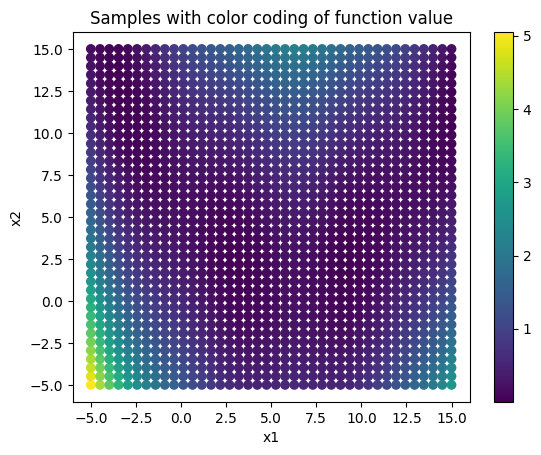

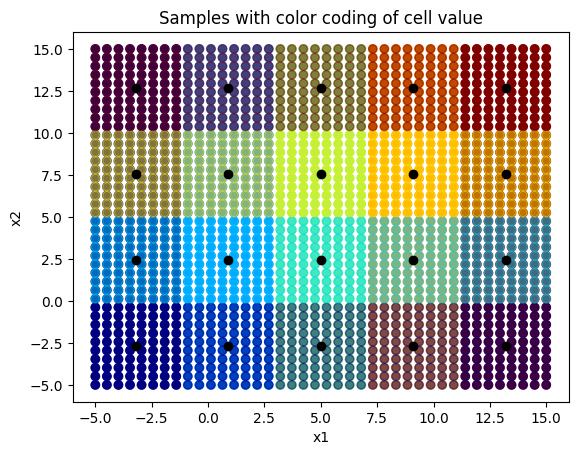

In [5]:
# Defining cells
icell = np.array((0, 1,  2, 3, 4))
jcell = np.array((0, 1, 2, 3))
cxs = np.zeros((xs.shape[0], 4))
cxs[:, 0:2]=xs

iblock = len(icell)
iseg = int(N_total*N_total/iblock)
jblock = len(jcell)
jseg = int(N_total*N_total/(jblock*iblock))

for i in range(iblock):
  cxs[i*iseg:(i+1)*iseg +1, -2]=icell[i]

for j in range(cxs.shape[0]):
  if (cxs[j, 1] <= (ub-lb)/4 + lb):
    cxs[j, -1]=jcell[0]
  if (cxs[j, 1] > (ub-lb)/4 + lb) and (cxs[j, 1] <= 2*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[1]
  if (cxs[j, 1] > 2*(ub-lb)/4 + lb) and (cxs[j, 1] <= 3*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[2]
  if (cxs[j, 1] > 3*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[3]

center = np.zeros((jblock, iblock, 2))

for i in range(iblock):
  for j in range(jblock):
    center[j,i,1] = (np.max(cxs[cxs[:, -1]==j,1])+np.min(cxs[cxs[:, -1]==j,1]))/2
    center[j,i,0] = (np.max(cxs[cxs[:, -2]==i,0])+np.min(cxs[cxs[:, -2]==i,0]))/2

plt.scatter(cxs[:, 0], cxs[:, 1], c=ys/100, cmap="viridis")
plt.colorbar(orientation='vertical')
plt.xlabel("x1")
plt.ylabel("x2")
plt.title("Samples with color coding of function value")
plt.show()

plt.scatter(cxs[:, 0], cxs[:, 1], c=cxs[:, -2], cmap="jet", alpha = 1)
#plt.colorbar(orientation='vertical')
plt.scatter(cxs[:, 0], cxs[:, 1], c=cxs[:, -1], cmap="jet", alpha = 0.5)
#plt.colorbar(orientation='vertical')
plt.scatter(center[:,:,0], center[:,:, 1], c="k")
plt.xlabel("x1")
plt.ylabel("x2")
plt.title("Samples with color coding of cell value")
plt.show()

# Cost aware Bayesian Optimization

Initial Sampling- 10 samples

In [6]:
n = 10

np.random.seed(10)
train_xs = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 2)
train_xs_norm = (train_xs-bounds[0])/(bounds[1]-bounds[0])
train_x = np.zeros((train_xs.shape[0], 4))
train_x_norm = np.zeros((train_xs_norm.shape[0], 4))
for i in range(train_xs.shape[0]):
  train_x[i, 0:2] = train_xs[i]
  train_x_norm[i, 0:2] = train_xs_norm[i]
  if train_xs[i,0]<=-1:
    train_x[i, -2] = 0
    train_x_norm[i, -2] = 0
  if train_xs[i,0]>-1 and train_xs[i,0]<=3:
    train_x[i, -2] = 1
    train_x_norm[i, -2] = 1
  if train_xs[i,0]>3 and train_xs[i,0]<=7:
    train_x[i, -2] = 2
    train_x_norm[i, -2] = 2
  if train_xs[i,0]>7 and train_xs[i,0]<=11:
    train_x[i, -2] = 3
    train_x_norm[i, -2] = 3
  if train_xs[i, 0]>11:
    train_x[i, -2] = 4
    train_x_norm[i, -2] = 4

for i in range(train_xs.shape[0]):
  if train_xs[i,1]<=0:
    train_x[i, -1] = 0
    train_x_norm[i, -1] = 0
  if train_xs[i,1]>0 and train_xs[i,1]<=5:
    train_x[i, -1] = 1
    train_x_norm[i, -1] = 1
  if train_xs[i,1]>5 and train_xs[i,1]<=10:
    train_x[i, -1] = 2
    train_x_norm[i, -1] = 2
  if train_xs[i, 1]>10:
    train_x[i, -1] = 3
    train_x_norm[i, -1] = 3

train_xs, train_xs_norm, train_x, train_x_norm

(array([[10.42641287, -4.58496101],
        [ 7.6729647 ,  9.97607765],
        [ 4.97014025, -0.50406709],
        [-1.0387427 , 10.21061424],
        [-1.61778327, -3.23320372],
        [ 8.70719637, 14.06786692],
        [-4.92103467,  5.24384527],
        [11.25241923,  7.25052134],
        [ 9.43510635,  0.83752136],
        [13.35548245,  9.29151567]]),
 array([[0.77132064, 0.02075195],
        [0.63364823, 0.74880388],
        [0.49850701, 0.22479665],
        [0.19806286, 0.76053071],
        [0.16911084, 0.08833981],
        [0.68535982, 0.95339335],
        [0.00394827, 0.51219226],
        [0.81262096, 0.61252607],
        [0.72175532, 0.29187607],
        [0.91777412, 0.71457578]]),
 array([[10.42641287, -4.58496101,  3.        ,  0.        ],
        [ 7.6729647 ,  9.97607765,  3.        ,  2.        ],
        [ 4.97014025, -0.50406709,  2.        ,  0.        ],
        [-1.0387427 , 10.21061424,  0.        ,  3.        ],
        [-1.61778327, -3.23320372,  0.        , 

In [7]:
train_y = objective(train_x[:,0:2])
train_y=train_y/100
train_y

Array([0.69377858, 0.85384909, 0.15633857, 0.20717991, 1.57076504,
       1.49942526, 1.492684  , 0.20292425, 0.03108389, 0.19029259],      dtype=float64)

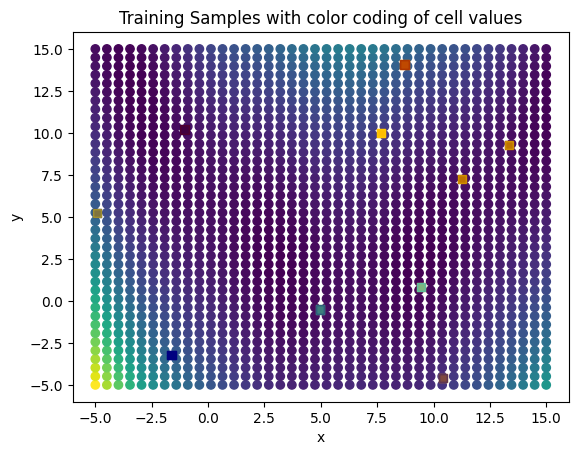

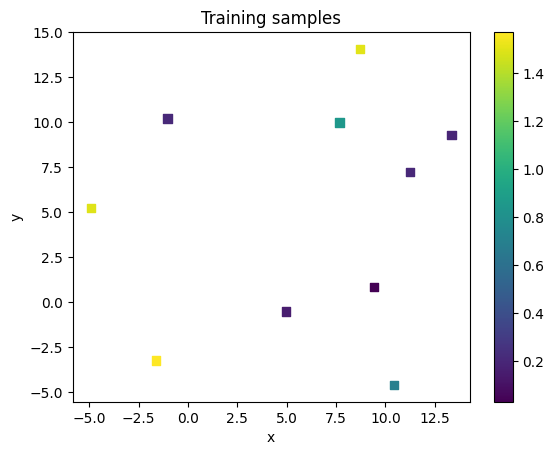

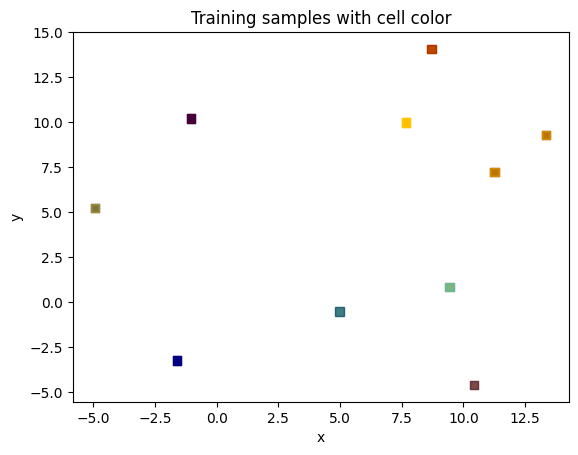

In [8]:
plt.scatter(xs[:, 0], xs[:, 1], c=ys/100, cmap="viridis")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training Samples with color coding of cell values")
plt.show()

plt.scatter(train_x[:, 0], train_x[:, 1], c=train_y, cmap="viridis", marker="s")
plt.colorbar(orientation='vertical')
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training samples")
plt.show()

plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training samples with cell color")
plt.show()

Run BO- 20 iterations

In [9]:
t_m = 1 # cost of measurement within cell
t_c = 20 # cost of measurement between two adjacent cells
a = 1

Step:1


sample: 100%|██████████| 1000/1000 [00:03<00:00, 285.97it/s, 7 steps of size 7.30e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.30      2.34      1.64      0.07      4.61    449.13      1.00
    k_scale      1.20      1.22      0.86      0.04      2.52    325.00      1.01
      noise      0.57      0.30      0.50      0.17      0.99    313.35      1.00



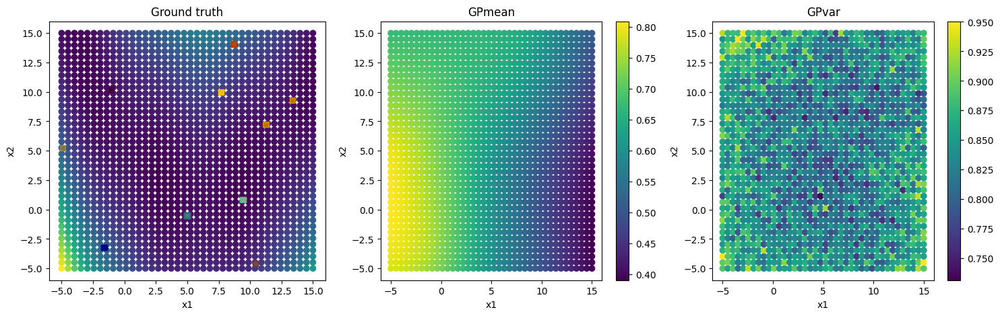

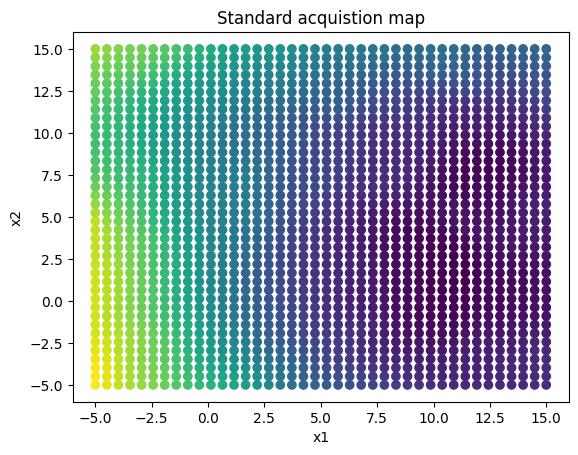

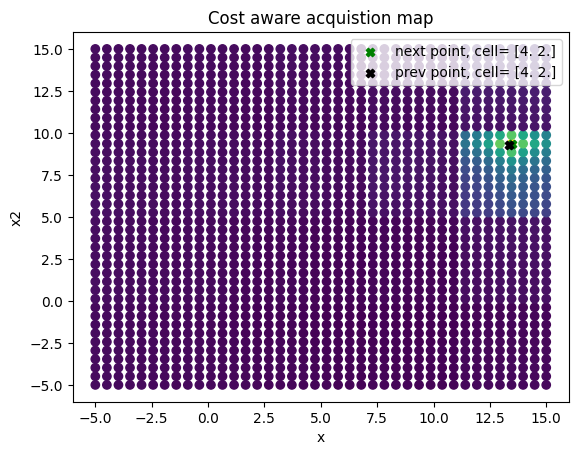

Measurement cost witin cell:1.173514702300137
Measurement cost between cell:0.0
1468
Step:2


sample: 100%|██████████| 1000/1000 [00:03<00:00, 315.59it/s, 7 steps of size 6.49e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.09      2.39      1.49      0.14      4.12    238.40      1.00
    k_scale      1.08      0.98      0.78      0.06      2.20    282.65      1.00
      noise      0.49      0.25      0.42      0.12      0.87    289.13      1.01



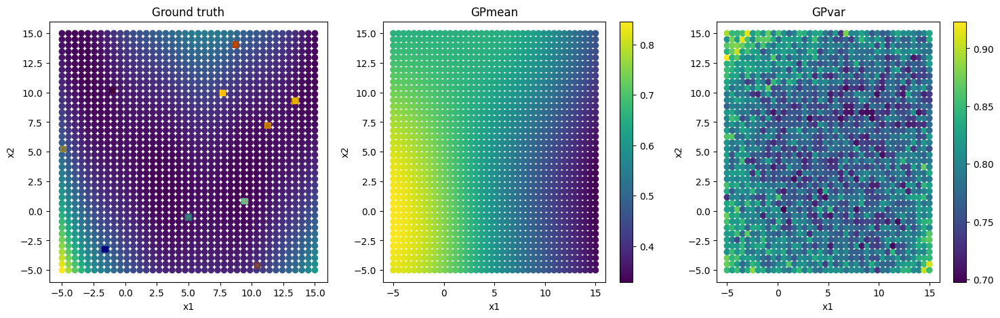

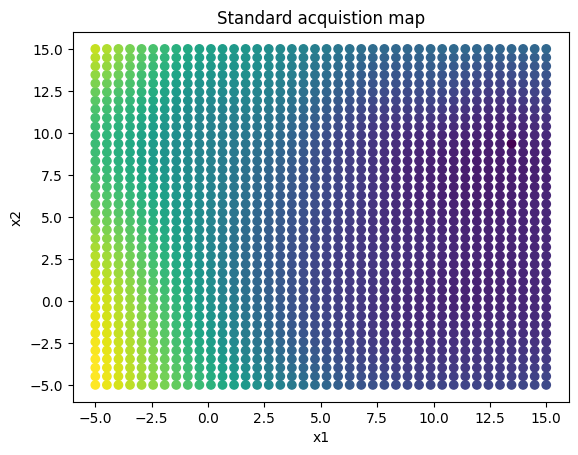

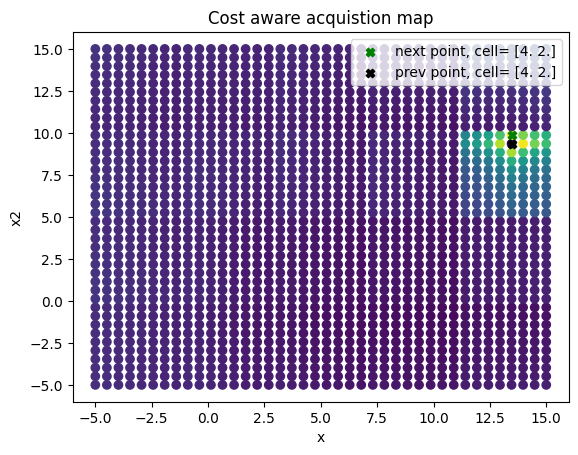

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469]
Step:3


sample: 100%|██████████| 1000/1000 [00:03<00:00, 317.45it/s, 7 steps of size 5.80e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.83      2.38      1.29      0.15      3.32    315.93      1.00
    k_scale      1.19      1.17      0.81      0.11      2.53    376.12      1.00
      noise      0.44      0.23      0.38      0.09      0.78    226.97      1.00



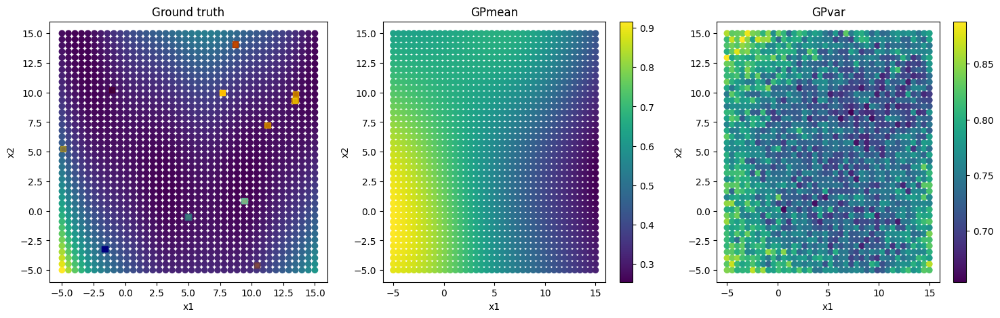

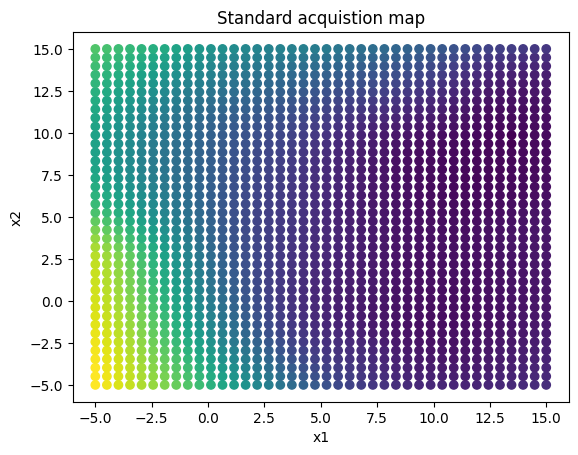

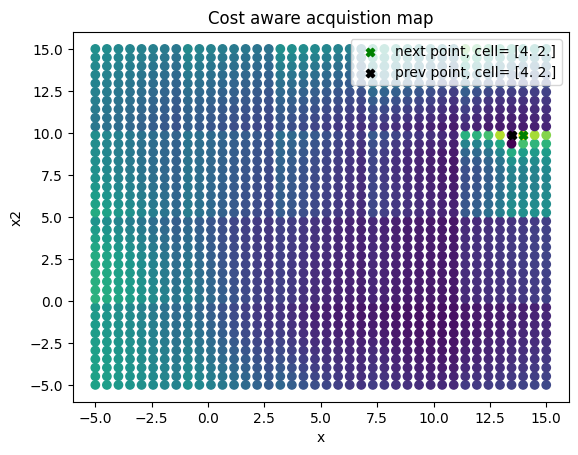

Measurement cost witin cell:1.512820512820511
Measurement cost between cell:0.0
[1468 1469 1509]
Step:4


sample: 100%|██████████| 1000/1000 [00:03<00:00, 308.23it/s, 3 steps of size 5.82e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.55      1.40      1.18      0.10      3.10    329.85      1.00
    k_scale      1.15      1.14      0.82      0.10      2.37    231.02      1.00
      noise      0.39      0.21      0.35      0.05      0.68    271.54      1.01



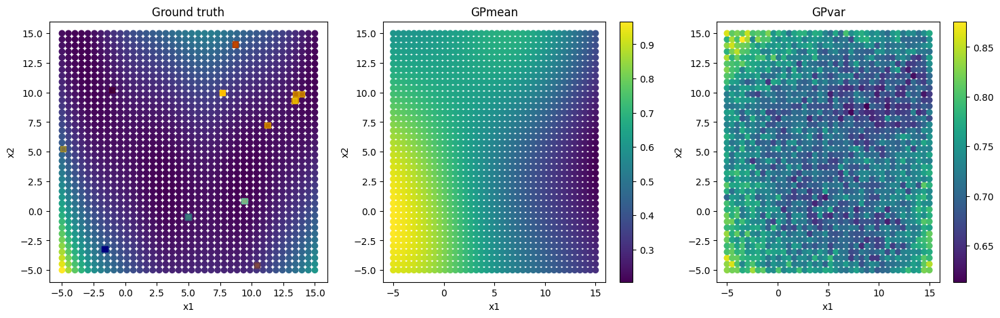

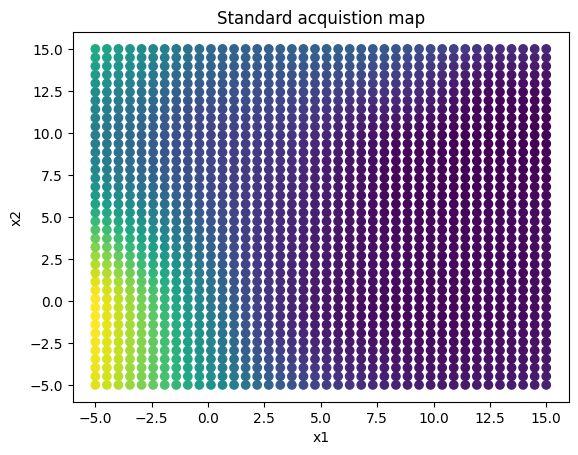

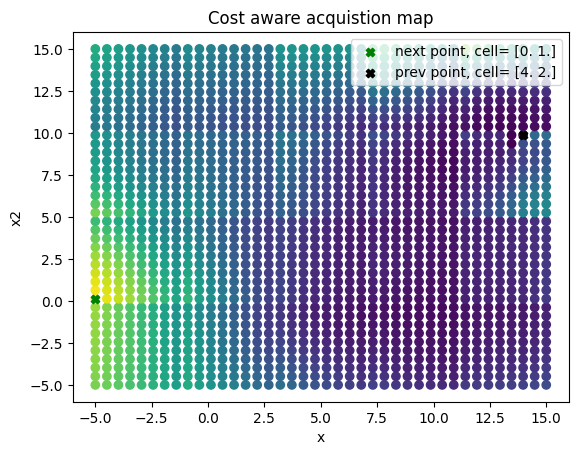

Measurement cost witin cell:0.0
Measurement cost between cell:101.0
[1468 1469 1509   10]
Step:5


sample: 100%|██████████| 1000/1000 [00:03<00:00, 299.49it/s, 15 steps of size 3.25e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.82      0.93      0.47      0.16      1.80    187.77      1.00
    k_scale      1.73      1.41      1.33      0.25      3.39    150.75      1.00
      noise      0.38      0.31      0.32      0.03      0.79    188.81      1.01



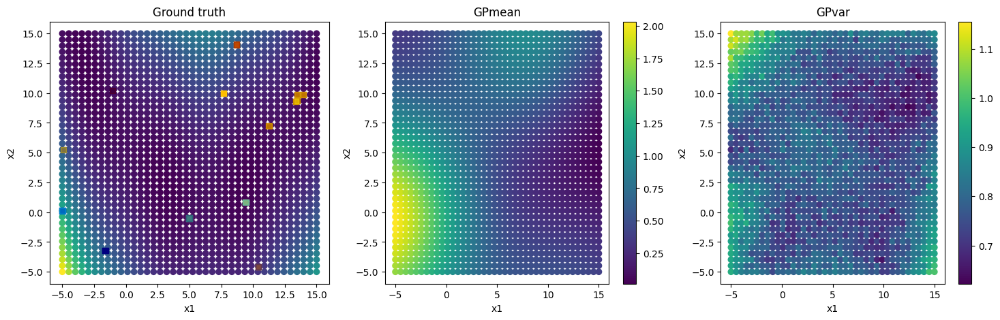

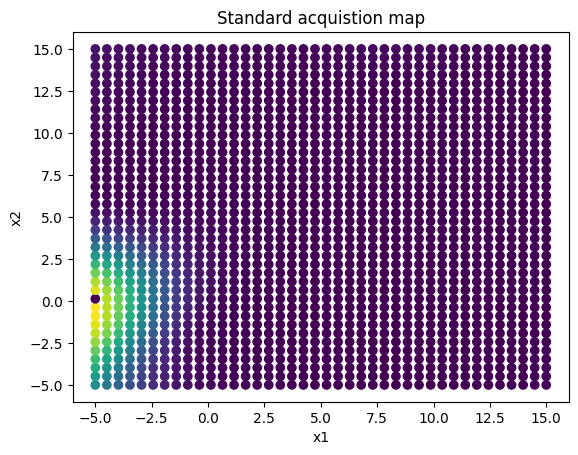

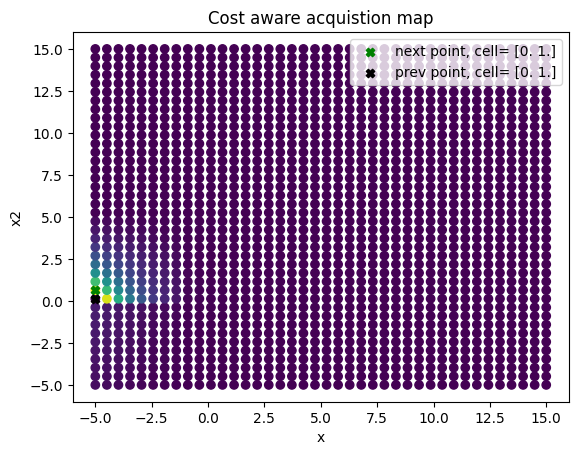

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469 1509   10   11]
Step:6


sample: 100%|██████████| 1000/1000 [00:03<00:00, 294.32it/s, 15 steps of size 2.52e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.40      0.38      0.34      0.18      0.56    343.95      1.00
    k_scale      1.78      1.01      1.49      0.51      3.17    290.78      1.00
      noise      0.18      0.20      0.12      0.01      0.40    176.03      1.00



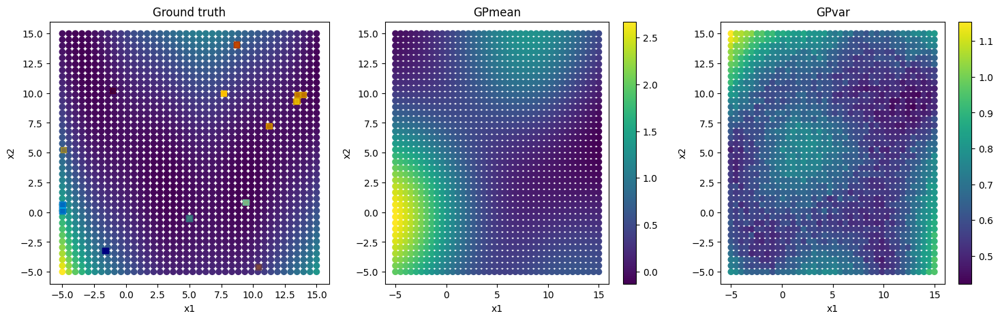

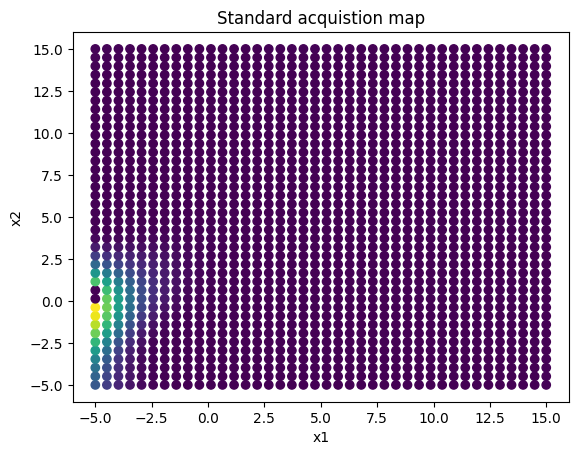

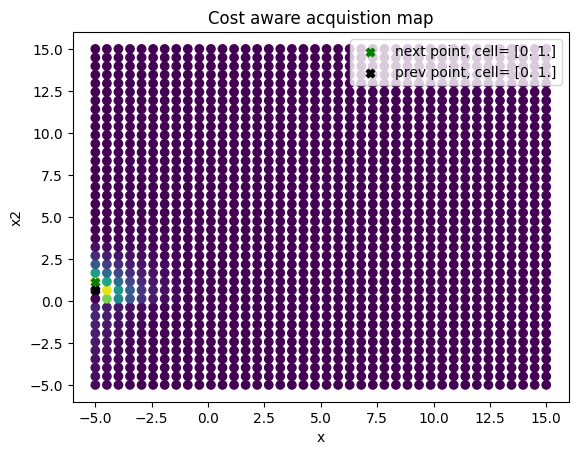

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12]
Step:7


sample: 100%|██████████| 1000/1000 [00:03<00:00, 304.45it/s, 7 steps of size 3.69e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.35      0.10      0.34      0.21      0.48    326.52      1.00
    k_scale      2.00      1.26      1.69      0.55      3.46    137.17      1.02
      noise      0.10      0.12      0.07      0.01      0.20    301.91      1.00



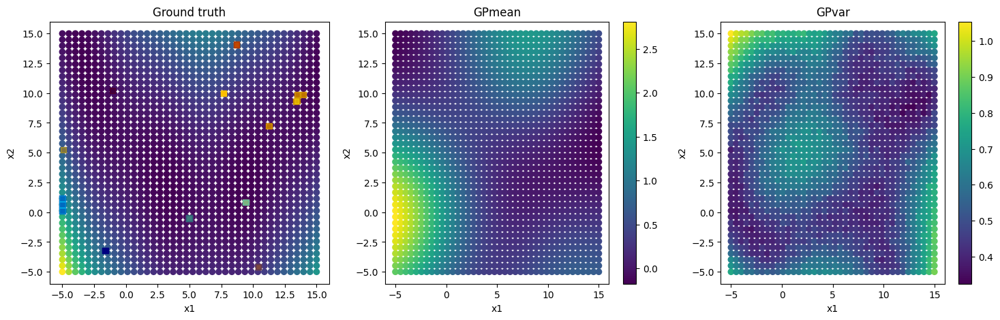

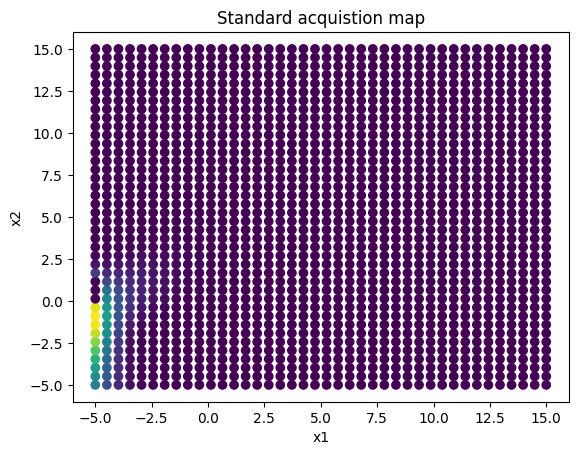

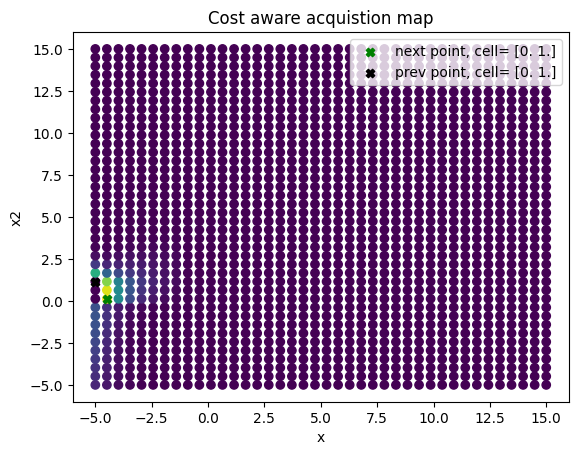

Measurement cost witin cell:2.5384615384615383
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50]
Step:8


sample: 100%|██████████| 1000/1000 [00:03<00:00, 295.71it/s, 7 steps of size 4.28e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.35      0.08      0.35      0.23      0.48    254.55      1.00
    k_scale      1.93      1.38      1.53      0.43      3.25    209.69      1.00
      noise      0.09      0.07      0.07      0.01      0.18    283.09      1.00



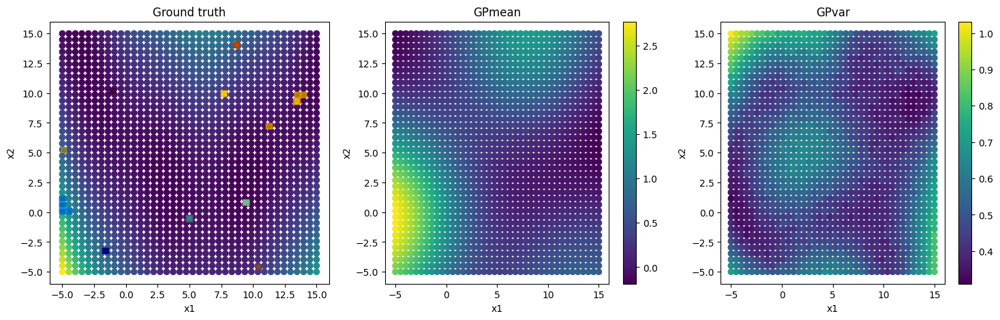

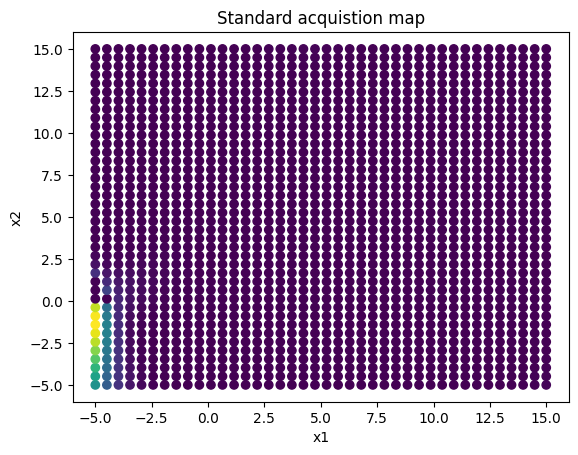

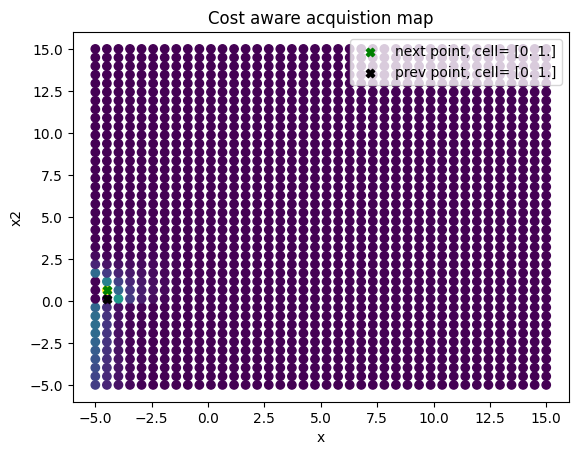

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51]
Step:9


sample: 100%|██████████| 1000/1000 [00:03<00:00, 281.44it/s, 7 steps of size 4.13e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.36      0.08      0.35      0.24      0.48    249.49      1.00
    k_scale      1.95      1.22      1.62      0.51      3.44    257.97      1.00
      noise      0.08      0.06      0.07      0.02      0.16    265.22      1.01



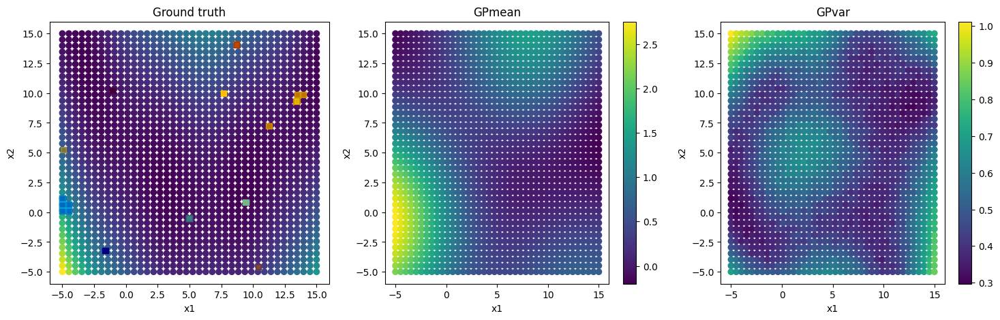

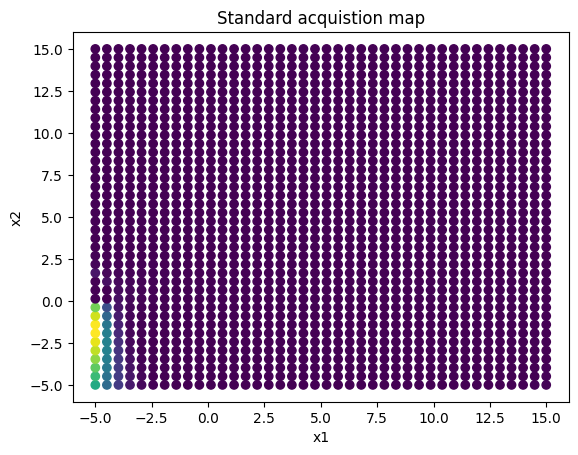

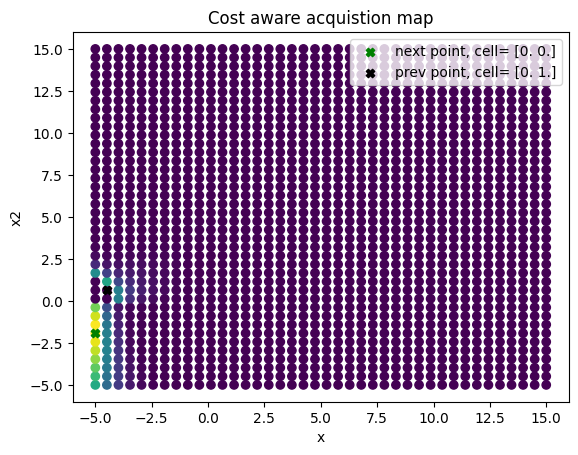

Measurement cost witin cell:0.0
Measurement cost between cell:21.0
[1468 1469 1509   10   11   12   50   51    6]
Step:10


sample: 100%|██████████| 1000/1000 [00:03<00:00, 277.41it/s, 3 steps of size 4.49e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.39      0.11      0.38      0.23      0.54    276.84      1.00
    k_scale      3.00      2.09      2.45      0.57      5.58    190.08      1.00
      noise      0.14      0.11      0.11      0.01      0.30    231.42      1.00



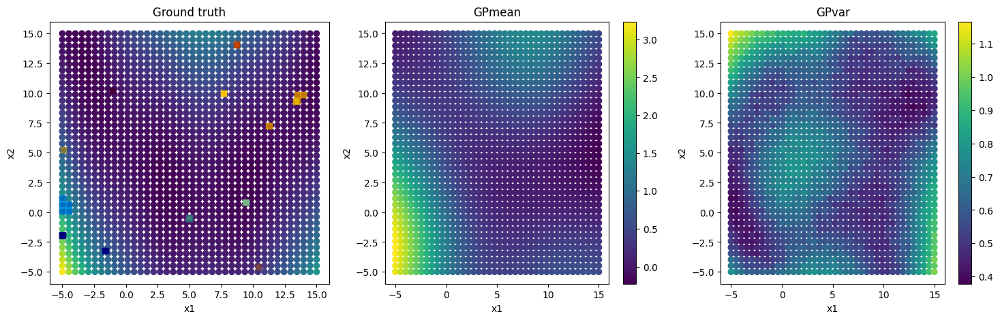

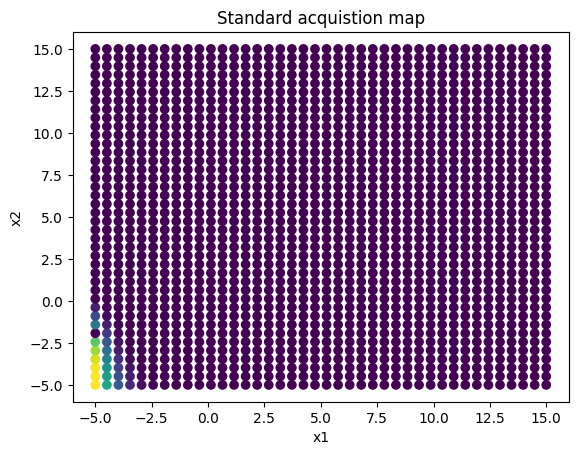

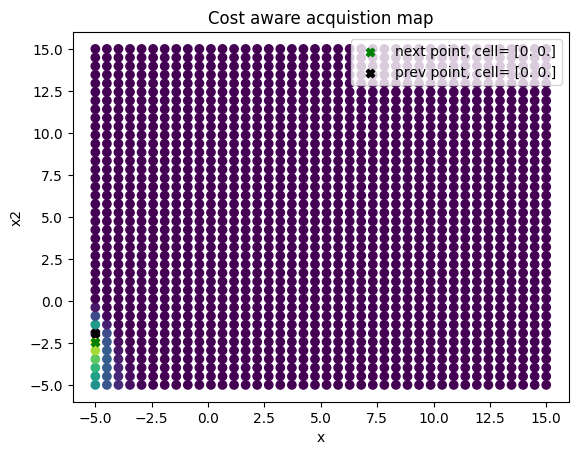

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5]
Step:11


sample: 100%|██████████| 1000/1000 [00:03<00:00, 290.40it/s, 7 steps of size 5.12e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.37      0.11      0.35      0.21      0.57    292.90      1.01
    k_scale      3.72      2.62      2.98      0.91      6.89    274.19      1.00
      noise      0.10      0.08      0.08      0.00      0.21    269.84      1.01



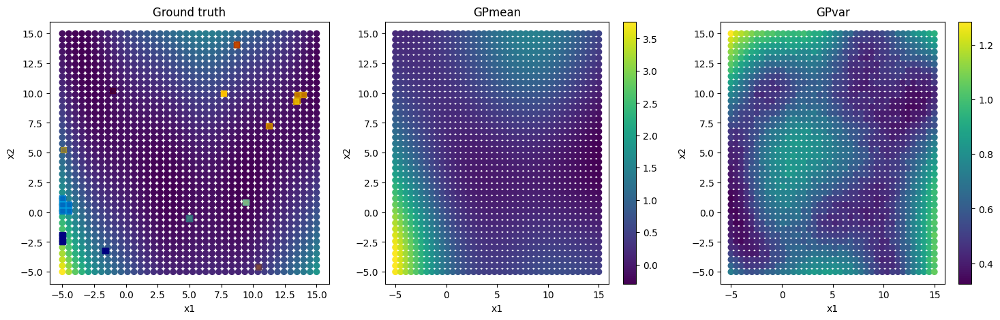

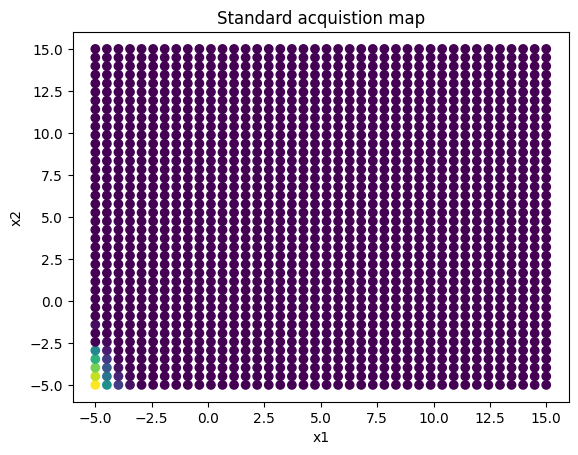

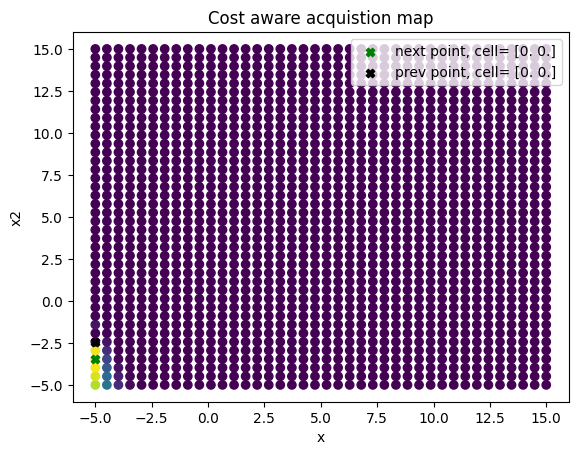

Measurement cost witin cell:2.0256410256410255
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5    3]
Step:12


sample: 100%|██████████| 1000/1000 [00:03<00:00, 287.23it/s, 7 steps of size 4.71e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.34      0.09      0.33      0.21      0.49    220.55      1.00
    k_scale      4.40      2.66      3.73      0.85      7.70    227.58      1.00
      noise      0.07      0.07      0.05      0.00      0.16    253.41      1.00



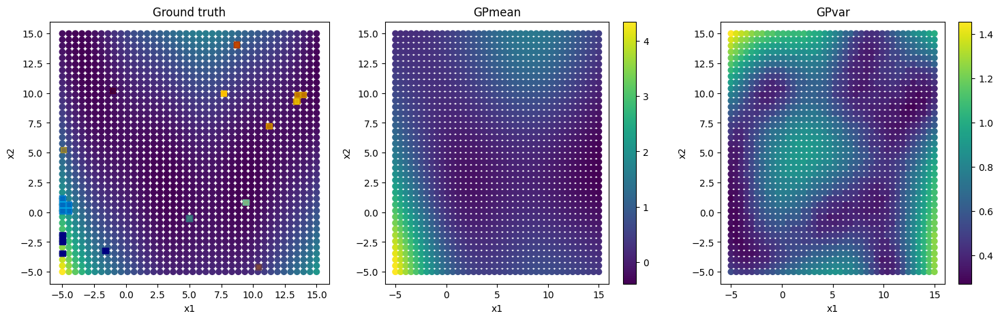

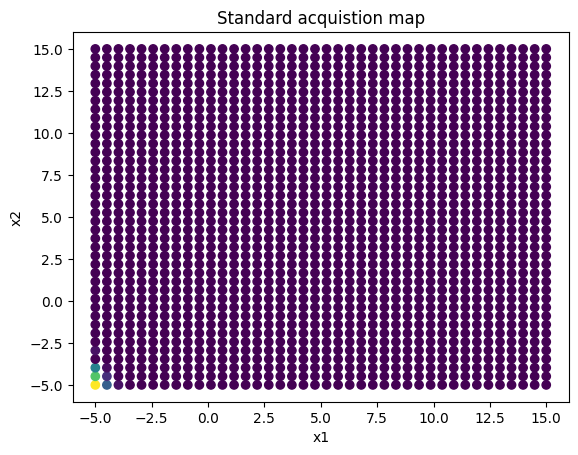

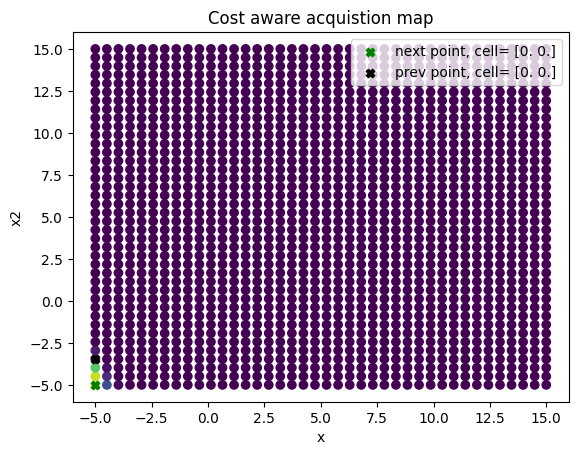

Measurement cost witin cell:2.5384615384615383
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0]
Step:13


sample: 100%|██████████| 1000/1000 [00:03<00:00, 275.09it/s, 7 steps of size 4.65e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.36      0.09      0.34      0.23      0.50    194.55      1.00
    k_scale      5.88      3.45      5.04      1.48     10.26    228.64      1.00
      noise      0.04      0.04      0.03      0.00      0.09    241.28      1.00



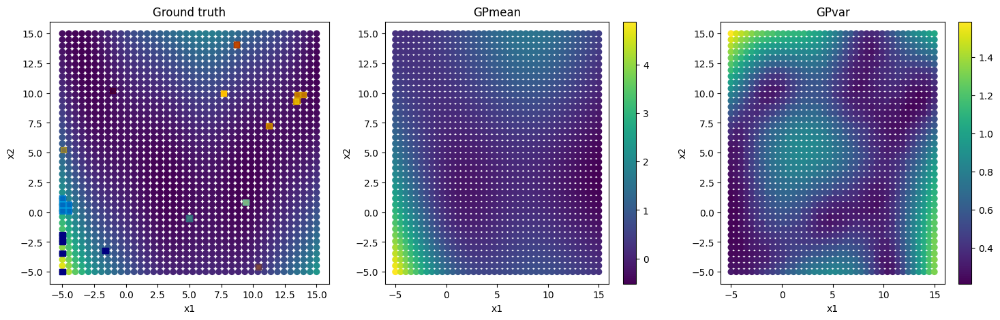

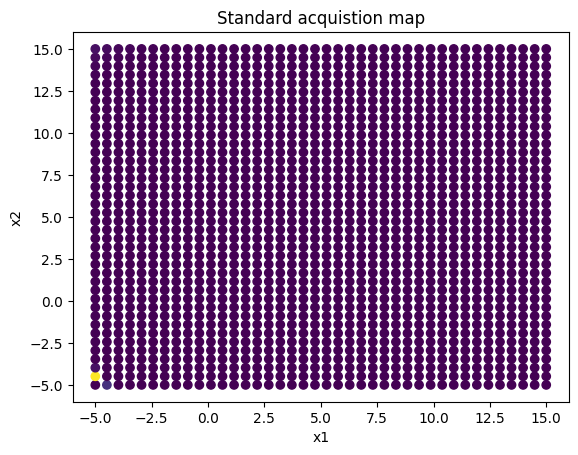

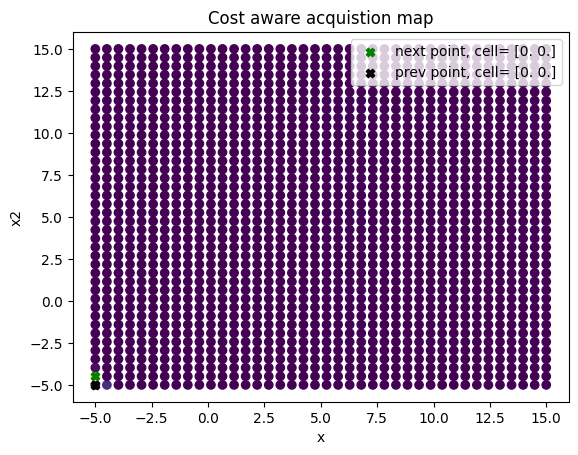

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1]
Step:14


sample: 100%|██████████| 1000/1000 [00:03<00:00, 275.85it/s, 7 steps of size 4.47e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.35      0.08      0.35      0.23      0.47    192.18      1.01
    k_scale      6.19      3.61      5.32      1.87     11.08    221.86      1.01
      noise      0.03      0.03      0.02      0.00      0.06    228.62      1.00



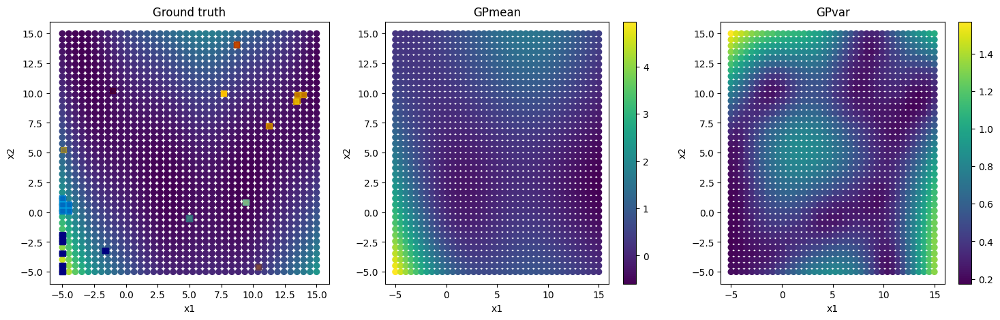

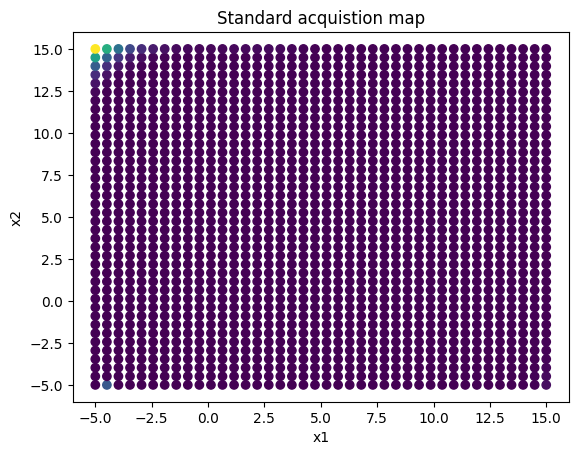

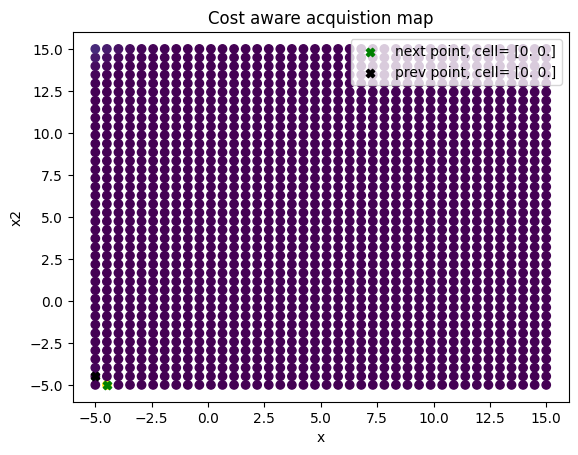

Measurement cost witin cell:2.0256410256410255
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40]
Step:15


sample: 100%|██████████| 1000/1000 [00:03<00:00, 254.05it/s, 7 steps of size 3.82e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.37      0.08      0.36      0.24      0.49    167.28      1.01
    k_scale      6.56      4.30      5.27      0.96     12.18    218.96      1.01
      noise      0.03      0.03      0.02      0.00      0.07    191.54      1.00



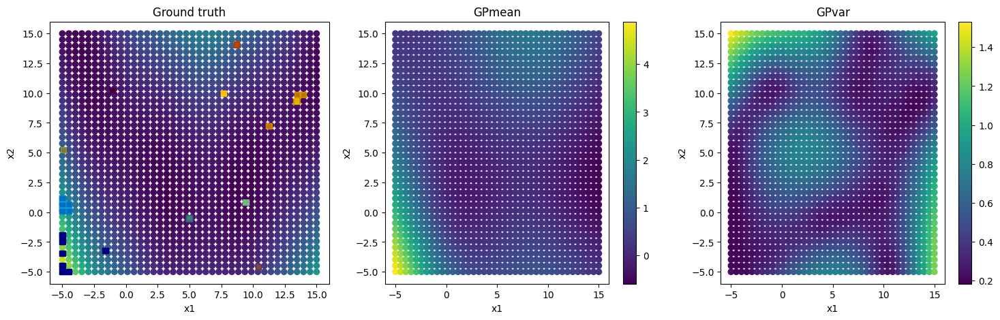

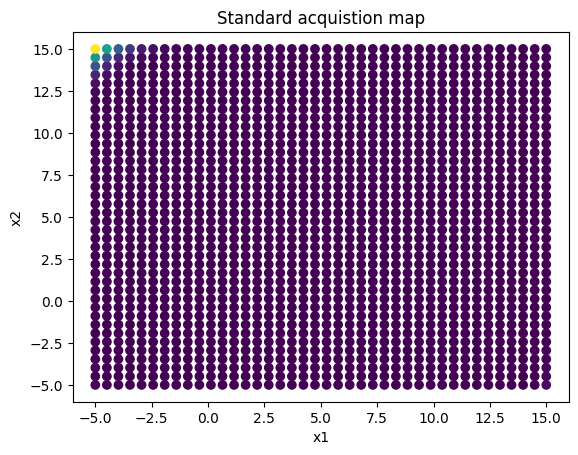

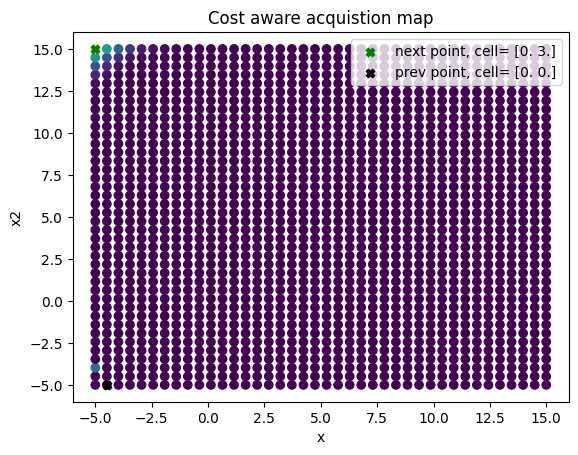

Measurement cost witin cell:0.0
Measurement cost between cell:61.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39]
Step:16


sample: 100%|██████████| 1000/1000 [00:03<00:00, 268.57it/s, 7 steps of size 4.03e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.37      0.09      0.37      0.24      0.52    103.73      1.01
    k_scale      6.67      4.37      5.48      0.97     12.63    108.77      1.01
      noise      0.03      0.03      0.02      0.00      0.06    128.06      1.01



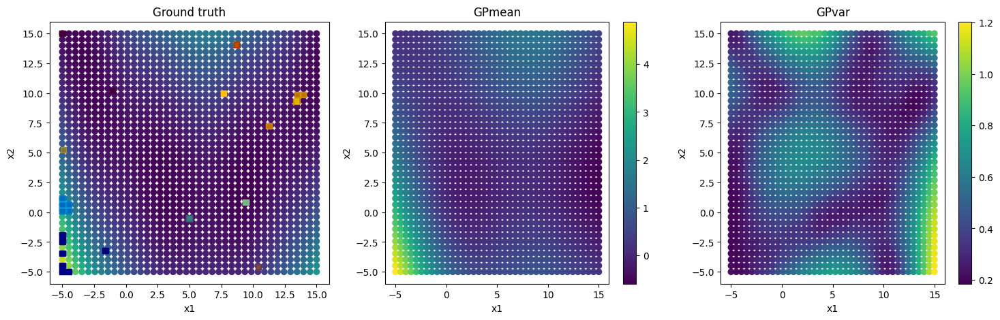

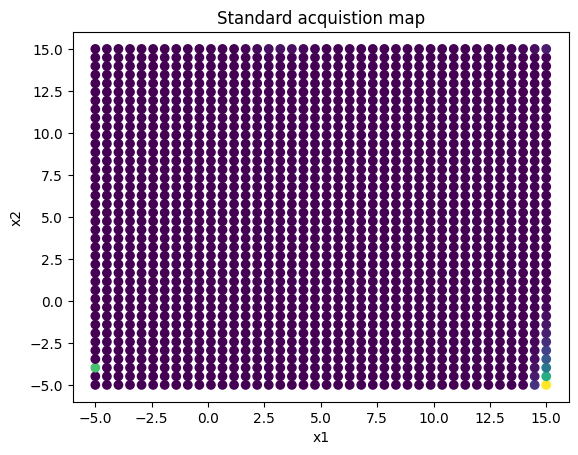

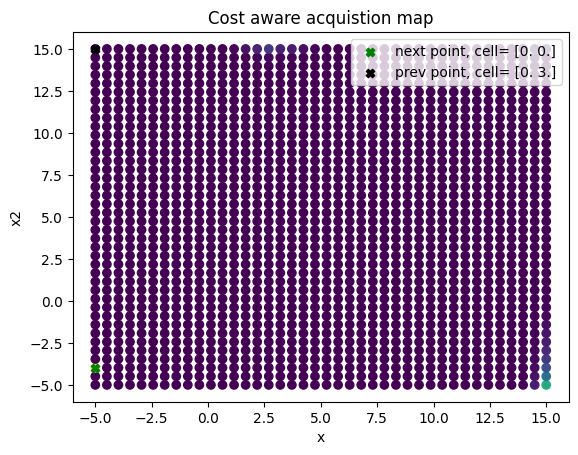

Measurement cost witin cell:0.0
Measurement cost between cell:61.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39    2]
Step:17


sample: 100%|██████████| 1000/1000 [00:03<00:00, 265.56it/s, 7 steps of size 3.84e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.37      0.07      0.37      0.25      0.48    158.23      1.01
    k_scale      6.67      4.04      5.72      1.74     12.36    180.56      1.00
      noise      0.02      0.02      0.02      0.00      0.04    148.97      1.02



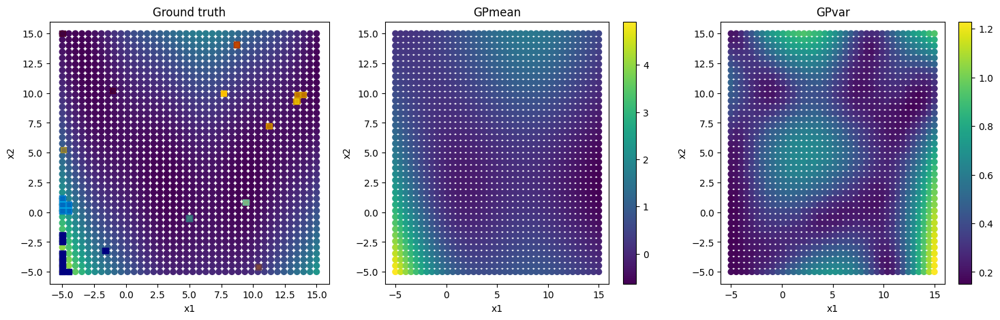

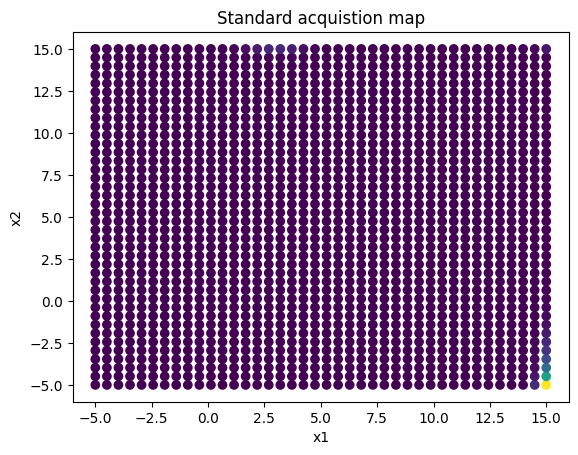

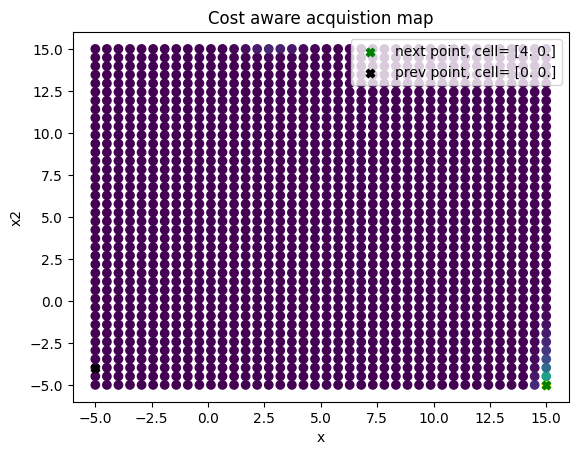

Measurement cost witin cell:0.0
Measurement cost between cell:81.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39    2 1560]
Step:18


sample: 100%|██████████| 1000/1000 [00:03<00:00, 262.39it/s, 7 steps of size 4.49e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.34      0.07      0.33      0.24      0.46    181.14      1.00
    k_scale      6.41      3.70      5.52      1.96     11.35    186.79      1.00
      noise      0.03      0.02      0.02      0.00      0.06    178.87      1.00



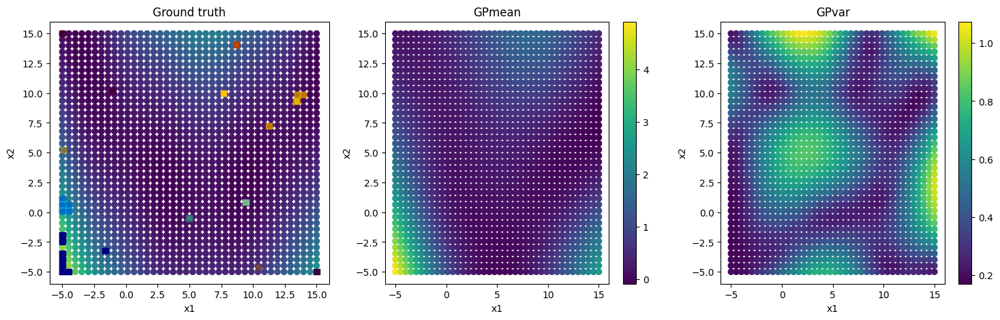

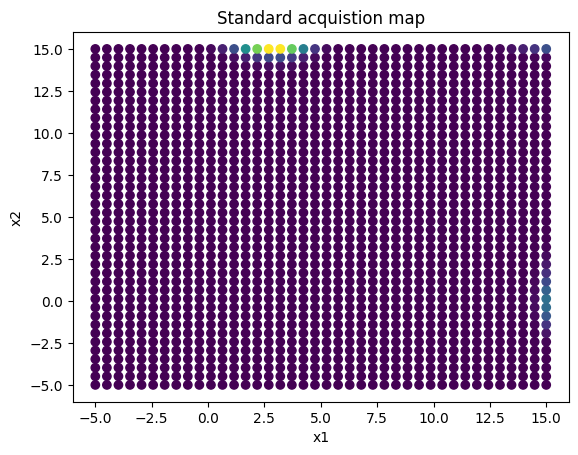

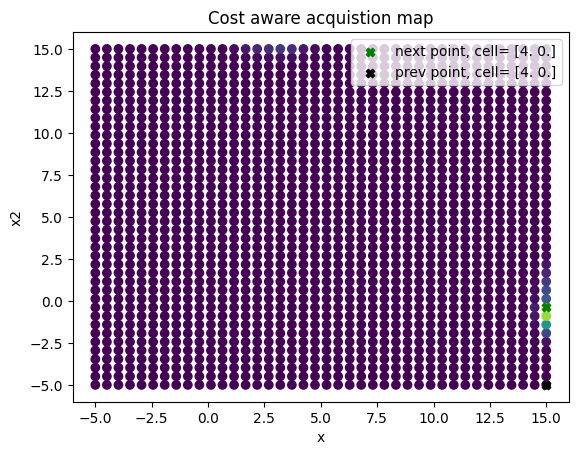

Measurement cost witin cell:5.615384615384615
Measurement cost between cell:0.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39    2 1560 1569]
Step:19


sample: 100%|██████████| 1000/1000 [00:03<00:00, 266.76it/s, 15 steps of size 4.14e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.35      0.07      0.34      0.23      0.46    255.42      1.00
    k_scale      6.12      3.38      5.35      1.69     11.00    232.13      1.00
      noise      0.03      0.02      0.02      0.00      0.05    238.35      1.00



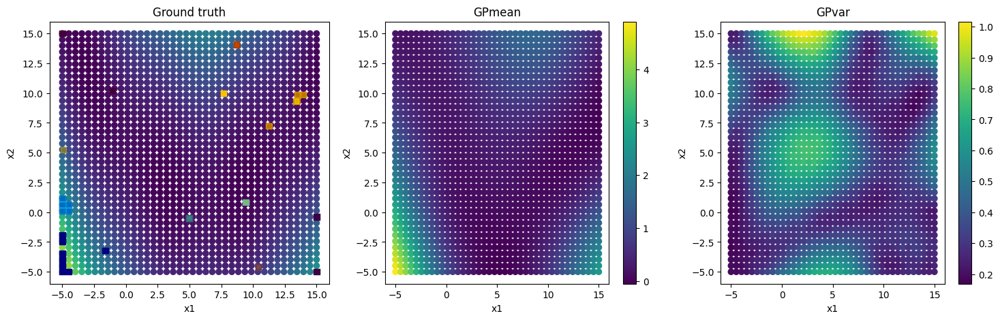

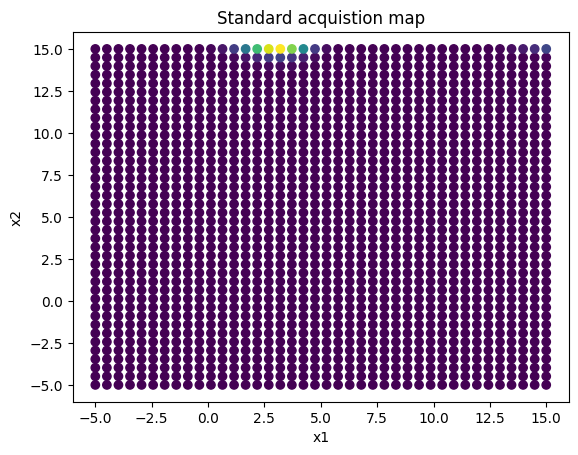

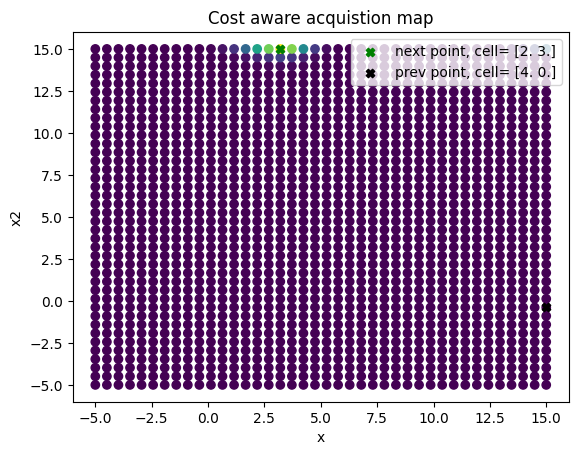

Measurement cost witin cell:0.0
Measurement cost between cell:101.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39    2 1560 1569  679]
Step:20


sample: 100%|██████████| 1000/1000 [00:03<00:00, 259.12it/s, 7 steps of size 3.71e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.37      0.09      0.35      0.25      0.51    148.96      1.00
    k_scale      7.10      4.83      5.83      1.76     13.41    203.41      1.01
      noise      0.03      0.02      0.02      0.00      0.06    166.10      1.00



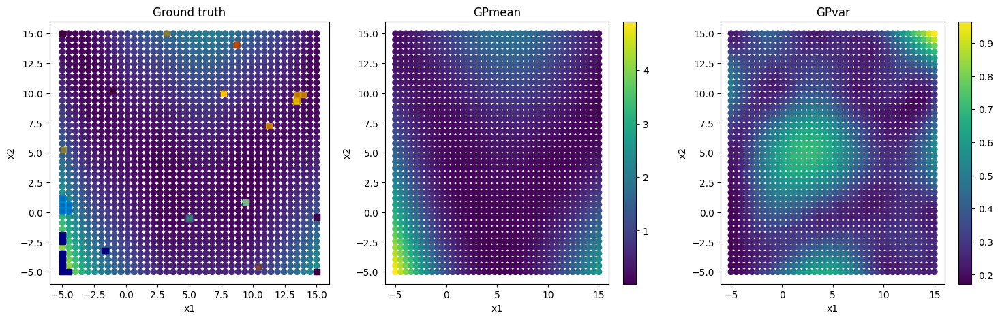

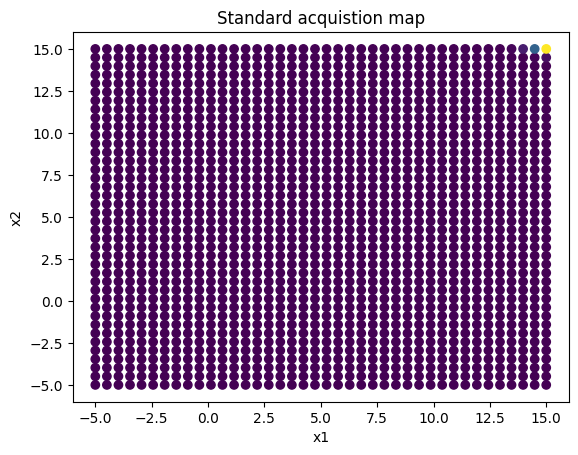

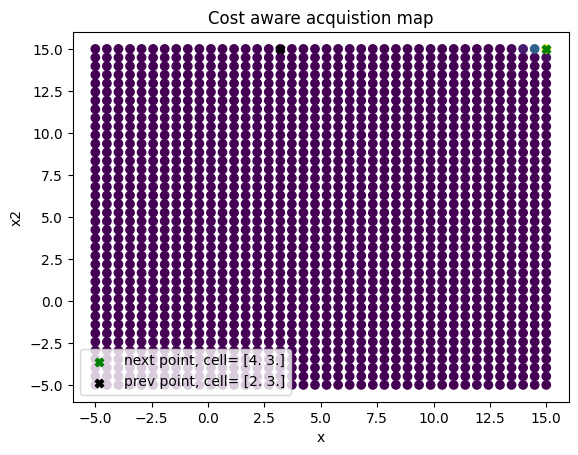

Measurement cost witin cell:0.0
Measurement cost between cell:41.0
[1468 1469 1509   10   11   12   50   51    6    5    3    0    1   40
   39    2 1560 1569  679 1599]


In [10]:
N = 20
X_test =cxs
X_test_full = cxs
X_test_norm = np.zeros_like(X_test)
X_test_norm[:, 0:2] = (X_test[:, 0:2]-bounds[0])/(bounds[1]-bounds[0])
X_test_norm[:, -2:] = X_test[:, -2:]

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel='RBF')
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_norm[:, 0:2], train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[:, 0:2])

        fig, ax = plt.subplots(ncols = 3, figsize=(18, 5))
        ax[0].scatter(X_test[:, 0], X_test[:, 1], c=ys/100, cmap="viridis")
        ax[0].scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
        ax[0].scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
        #plt.colorbar(b, orientation='vertical')
        ax[0].set_xlabel("x1")
        ax[0].set_ylabel("x2")
        ax[0].set_title("Ground truth")

        b= ax[1].scatter(X_test[:, 0], X_test[:, 1], c=y_pred, cmap="viridis")
        plt.colorbar(b, orientation='vertical')
        ax[1].set_xlabel("x1")
        ax[1].set_ylabel("x2")
        ax[1].set_title("GPmean")

        b= ax[2].scatter(X_test[:, 0], X_test[:, 1], c=y_sampled.std(axis=(0,1)), cmap="viridis")
        plt.colorbar(b, orientation='vertical')
        ax[2].set_xlabel("x1")
        ax[2].set_ylabel("x2")
        ax[2].set_title("GPvar")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    cost_params = [t_m, t_c, a, center]
    acq, next_point_idx, next_point_val,  cost[i-1, :] = cost_acqfun(gp_model, train_x, test_data, cost_params, rng_key_predict, idx, isnorm=True)
    print("Measurement cost witin cell:"+str(cost[i-1, 0]))
    print("Measurement cost between cell:"+str(cost[i-1, 1]))

    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        train_x = np.vstack((train_x, next_point))
        next_point_norm = X_test_norm[next_point_idx]
        train_x_norm = np.vstack((train_x_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)
        train_y = objective(train_x[:, 0:2])
        train_y=train_y/100



345.89146342024884


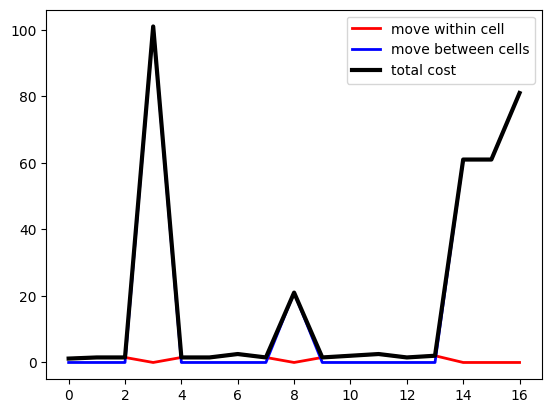

In [11]:
total_cost= np.sum(cost[:17,:])
print(total_cost)
plt.plot(cost[:17, 0], c="r", linewidth=2, label="move within cell")
plt.plot(cost[:17, 1], c="b", linewidth=2, label="move between cells")
plt.plot(np.sum(cost[:17, :],axis=1), c="k", linewidth=3, label="total cost")
plt.legend(loc="best")

We can see due to the cost, the acq function tries to gradually exploiting the cells and once the exploitation is done, it focus on exploring the next cell with potential better solution (observed from the jump).

The height of the jump denotes the difference between the cells, where moving to the next cell has lesser cost than moving to the farther cells.

We can see that due to the effect of the cost, it first explored to the nearest region of interest, and then gradually move towards more costly exploration to region of interest lies far away.

However, the cost related params need to be tuned for best outcome/trade-off between switching to different cells.

# Cost aware Structured BO

In [12]:
#define objective
def objective(x):
    # https://www.sfu.ca/~ssurjano/branin.html
    x1 = x[:, 0]
    x2 = x[:, 1]
    a = 1
    b = 5.1/(4*np.pi**2),
    c = 5/np.pi
    r = 6
    s = 10
    t = 1/(8*np.pi)
    y = a*(x2 - b*x1**2 + c*x1 - r)**2 + s*(1-t)*jnp.cos(x1) + s
    return y

lb = -5
ub = 15
N_total =40
xs1 = np.linspace(lb, ub, N_total)
xs2 = np.linspace(lb, ub, N_total)
xs = np.zeros((N_total*N_total,2))
k = 0
for i in range(len(xs1)):
  for j in range(len(xs2)):
    xs[k, 0] = xs1[i]
    xs[k, 1] = xs2[j]
    k = k+1
xs_norm = (xs-lb)/(ub-lb)
bounds = np.array((lb, ub), dtype=float)

ys = objective(xs)
ys_norm = (ys-np.min(ys))/(np.max(ys)-np.min(ys))


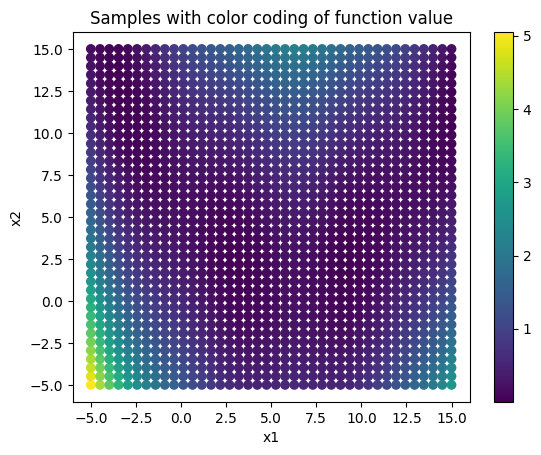

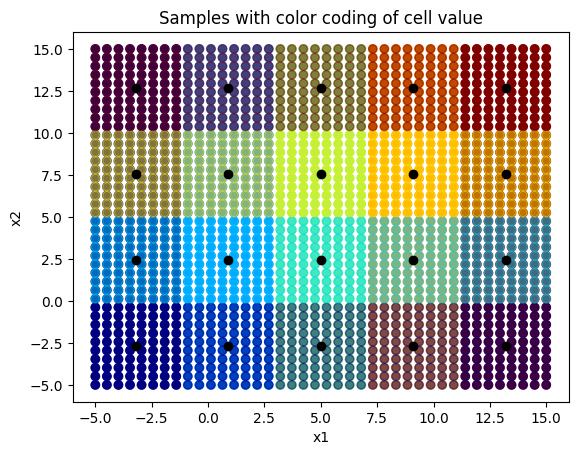

In [13]:
# Defining cells
icell = np.array((0, 1,  2, 3, 4))
jcell = np.array((0, 1, 2, 3))
cxs = np.zeros((xs.shape[0], 4))
cxs[:, 0:2]=xs

iblock = len(icell)
iseg = int(N_total*N_total/iblock)
jblock = len(jcell)
jseg = int(N_total*N_total/(jblock*iblock))

for i in range(iblock):
  cxs[i*iseg:(i+1)*iseg +1, -2]=icell[i]

for j in range(cxs.shape[0]):
  if (cxs[j, 1] <= (ub-lb)/4 + lb):
    cxs[j, -1]=jcell[0]
  if (cxs[j, 1] > (ub-lb)/4 + lb) and (cxs[j, 1] <= 2*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[1]
  if (cxs[j, 1] > 2*(ub-lb)/4 + lb) and (cxs[j, 1] <= 3*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[2]
  if (cxs[j, 1] > 3*(ub-lb)/4 + lb):
    cxs[j, -1]=jcell[3]

center = np.zeros((jblock, iblock, 2))

for i in range(iblock):
  for j in range(jblock):
    center[j,i,1] = (np.max(cxs[cxs[:, -1]==j,1])+np.min(cxs[cxs[:, -1]==j,1]))/2
    center[j,i,0] = (np.max(cxs[cxs[:, -2]==i,0])+np.min(cxs[cxs[:, -2]==i,0]))/2

plt.scatter(cxs[:, 0], cxs[:, 1], c=ys/100, cmap="viridis")
plt.colorbar(orientation='vertical')
plt.xlabel("x1")
plt.ylabel("x2")
plt.title("Samples with color coding of function value")
plt.show()

plt.scatter(cxs[:, 0], cxs[:, 1], c=cxs[:, -2], cmap="jet", alpha = 1)
#plt.colorbar(orientation='vertical')
plt.scatter(cxs[:, 0], cxs[:, 1], c=cxs[:, -1], cmap="jet", alpha = 0.5)
#plt.colorbar(orientation='vertical')
plt.scatter(center[:,:,0], center[:,:, 1], c="k")
plt.xlabel("x1")
plt.ylabel("x2")
plt.title("Samples with color coding of cell value")
plt.show()

Initial Sampling- 10 samples

In [14]:
n = 10

np.random.seed(10)
train_xs = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 2)
train_xs_norm = (train_xs-bounds[0])/(bounds[1]-bounds[0])
train_x = np.zeros((train_xs.shape[0], 4))
train_x_norm = np.zeros((train_xs_norm.shape[0], 4))
for i in range(train_xs.shape[0]):
  train_x[i, 0:2] = train_xs[i]
  train_x_norm[i, 0:2] = train_xs_norm[i]
  if train_xs[i,0]<=-1:
    train_x[i, -2] = 0
    train_x_norm[i, -2] = 0
  if train_xs[i,0]>-1 and train_xs[i,0]<=3:
    train_x[i, -2] = 1
    train_x_norm[i, -2] = 1
  if train_xs[i,0]>3 and train_xs[i,0]<=7:
    train_x[i, -2] = 2
    train_x_norm[i, -2] = 2
  if train_xs[i,0]>7 and train_xs[i,0]<=11:
    train_x[i, -2] = 3
    train_x_norm[i, -2] = 3
  if train_xs[i, 0]>11:
    train_x[i, -2] = 4
    train_x_norm[i, -2] = 4

for i in range(train_xs.shape[0]):
  if train_xs[i,1]<=0:
    train_x[i, -1] = 0
    train_x_norm[i, -1] = 0
  if train_xs[i,1]>0 and train_xs[i,1]<=5:
    train_x[i, -1] = 1
    train_x_norm[i, -1] = 1
  if train_xs[i,1]>5 and train_xs[i,1]<=10:
    train_x[i, -1] = 2
    train_x_norm[i, -1] = 2
  if train_xs[i, 1]>10:
    train_x[i, -1] = 3
    train_x_norm[i, -1] = 3

train_xs, train_xs_norm, train_x, train_x_norm

(array([[10.42641287, -4.58496101],
        [ 7.6729647 ,  9.97607765],
        [ 4.97014025, -0.50406709],
        [-1.0387427 , 10.21061424],
        [-1.61778327, -3.23320372],
        [ 8.70719637, 14.06786692],
        [-4.92103467,  5.24384527],
        [11.25241923,  7.25052134],
        [ 9.43510635,  0.83752136],
        [13.35548245,  9.29151567]]),
 array([[0.77132064, 0.02075195],
        [0.63364823, 0.74880388],
        [0.49850701, 0.22479665],
        [0.19806286, 0.76053071],
        [0.16911084, 0.08833981],
        [0.68535982, 0.95339335],
        [0.00394827, 0.51219226],
        [0.81262096, 0.61252607],
        [0.72175532, 0.29187607],
        [0.91777412, 0.71457578]]),
 array([[10.42641287, -4.58496101,  3.        ,  0.        ],
        [ 7.6729647 ,  9.97607765,  3.        ,  2.        ],
        [ 4.97014025, -0.50406709,  2.        ,  0.        ],
        [-1.0387427 , 10.21061424,  0.        ,  3.        ],
        [-1.61778327, -3.23320372,  0.        , 

In [15]:
train_y = objective(train_x[:,0:2])
train_y=(train_y-np.min(ys))/(np.max(ys)-np.min(ys))
train_y

Array([0.13666413, 0.16838744, 0.03015248, 0.04022838, 0.31046824,
       0.29632988, 0.29499388, 0.03938498, 0.00532908, 0.0368816 ],      dtype=float64)

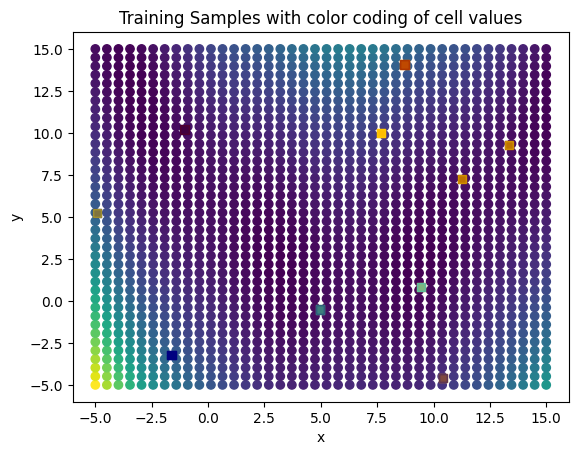

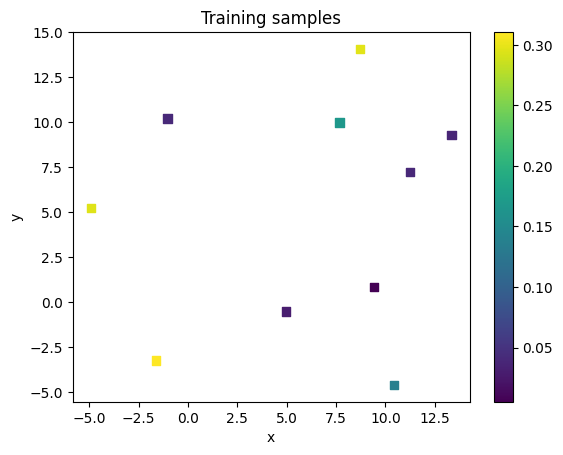

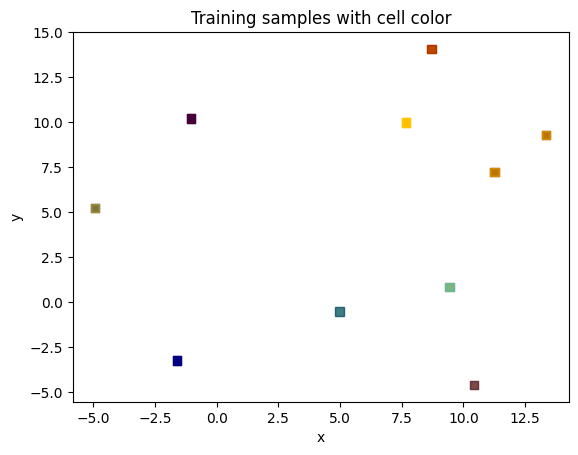

In [16]:
plt.scatter(xs[:, 0], xs[:, 1], c=ys/100, cmap="viridis")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training Samples with color coding of cell values")
plt.show()

plt.scatter(train_x[:, 0], train_x[:, 1], c=train_y, cmap="viridis", marker="s")
plt.colorbar(orientation='vertical')
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training samples")
plt.show()

plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
plt.scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Training samples with cell color")
plt.show()

In [17]:
t_m = 1
t_c = 20
a = 1

Here we defined the prioir mean function based on the knowledge of having region of interest at one of the corner cells, however the location of the optimal corner cell is assumed unknown which the sGP is tasked to find.

We can definitely define mean function which different prior knowledge, which will have an impact of the overall exploration along with the cost awareness

In [18]:
@jit
def mean_func(x, params):

    x_data = x[:,0:2]
    #jax.debug.print("x_data: {}", x_data.shape)
    #lb = -5
    #ub = 15
    #x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)

    return  jnp.absolute(x_data[:, 0]-params["a"])*params["c"] + jnp.absolute(x_data[:, 1]-params["b"])*params["c"]


def mf_priors():
    a = numpyro.sample("a", numpyro.distributions.HalfNormal(0.5))
    b = numpyro.sample("b", numpyro.distributions.HalfNormal(0.5))
    c = numpyro.sample("c", numpyro.distributions.HalfNormal(2))
    return {"a": a, "b": b, "c": c}

Run BO- 15 iterations

Step:1


sample: 100%|██████████| 1000/1000 [00:04<00:00, 232.51it/s, 7 steps of size 3.78e-01. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.45      0.27      0.42      0.02      0.82    329.01      1.00
          b      0.39      0.26      0.34      0.00      0.75    235.42      1.00
          c      0.37      0.27      0.33      0.00      0.72    277.73      1.00
k_length[0]      2.72      2.36      2.03      0.28      5.48    261.61      1.00
    k_scale      0.66      0.72      0.43      0.02      1.47    210.18      1.00
      noise      0.09      0.09      0.07      0.01      0.20    252.07      1.00



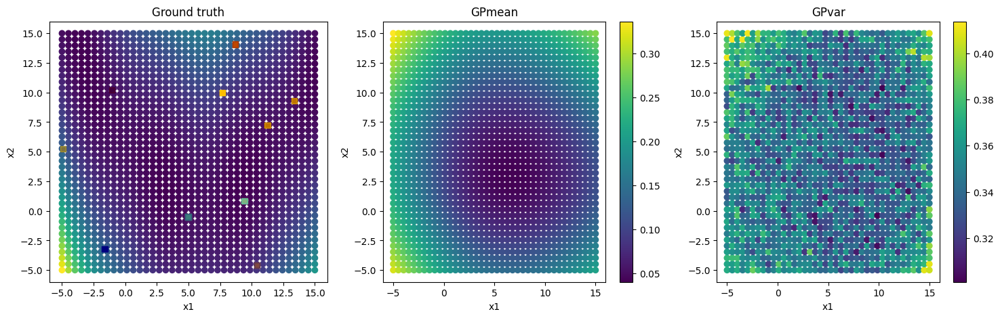

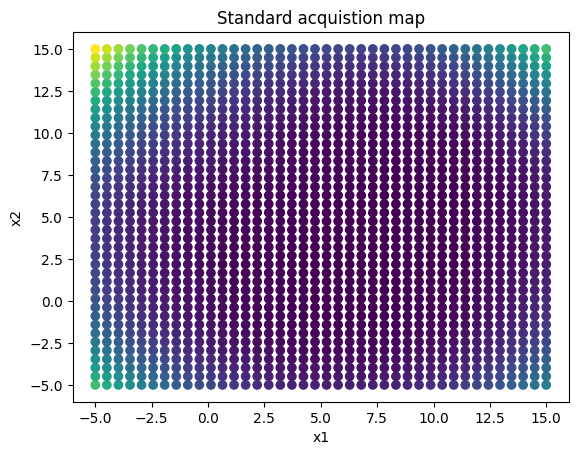

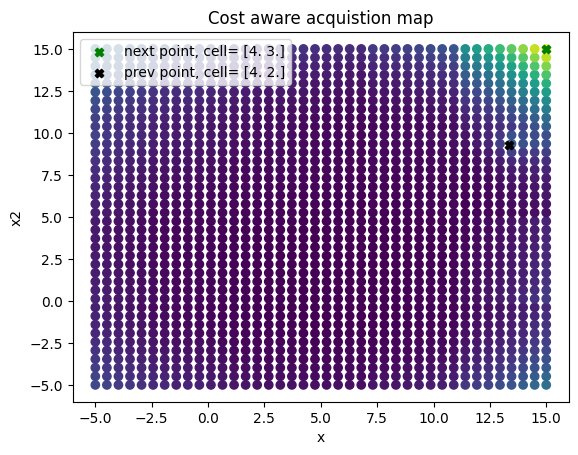

Measurement cost witin cell:0.0
Measurement cost between cell:3.0
1599
Step:2


sample: 100%|██████████| 1000/1000 [00:04<00:00, 230.70it/s, 7 steps of size 2.98e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.63      0.35      0.59      0.11      1.14    291.85      1.00
          b      0.39      0.27      0.35      0.00      0.76    345.95      1.01
          c      0.82      0.51      0.77      0.01      1.47    194.78      1.00
k_length[0]      1.90      2.53      1.17      0.06      3.89    300.28      1.00
    k_scale      0.93      0.95      0.65      0.06      2.00    276.55      1.00
      noise      0.47      0.29      0.40      0.09      0.85    405.85      1.00



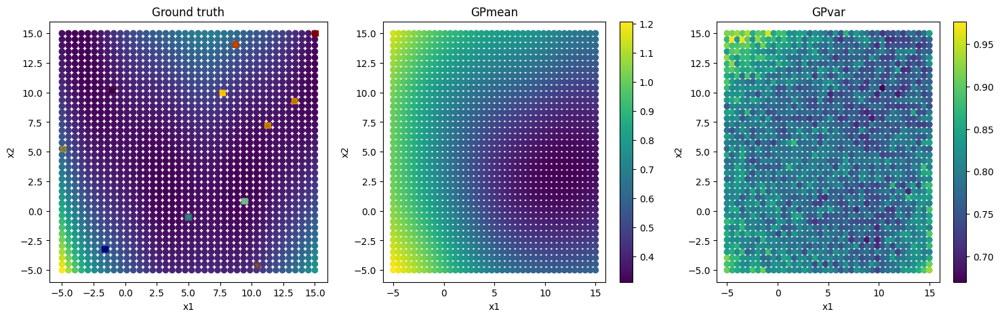

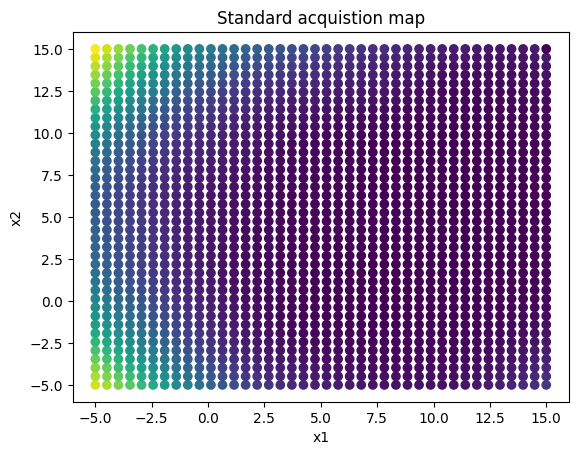

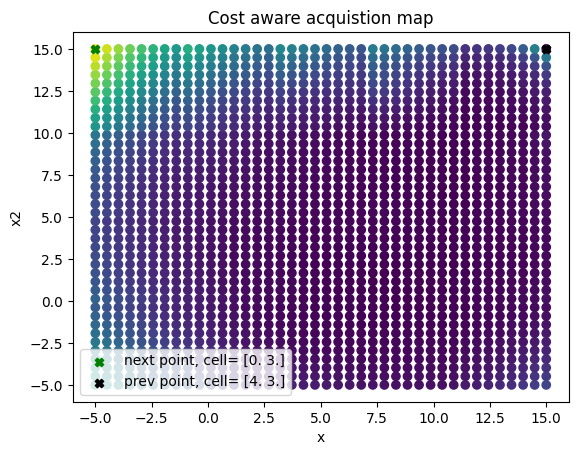

Measurement cost witin cell:0.0
Measurement cost between cell:9.0
[1599   39]
Step:3


sample: 100%|██████████| 1000/1000 [00:04<00:00, 201.58it/s, 15 steps of size 3.51e-01. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.32      0.44      0.00      0.96    267.51      1.00
          b      0.42      0.32      0.35      0.00      0.88    219.29      1.00
          c      0.57      0.42      0.47      0.00      1.14    162.03      1.02
k_length[0]      2.05      2.27      1.23      0.08      4.67    298.68      1.00
    k_scale      0.85      0.83      0.59      0.04      1.95    272.39      1.00
      noise      0.52      0.31      0.44      0.08      0.92    279.87      1.01



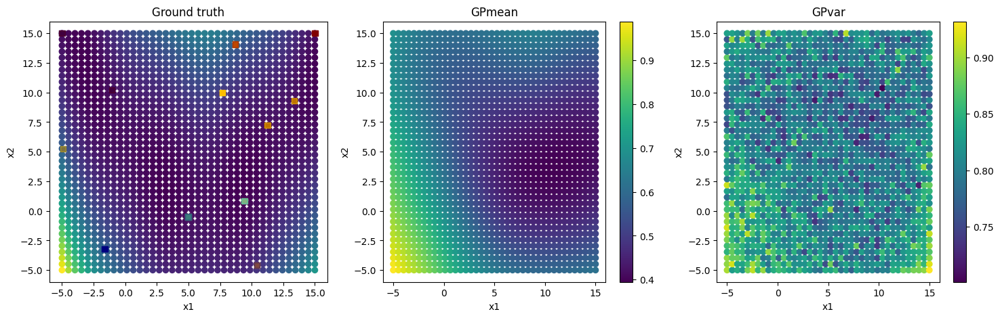

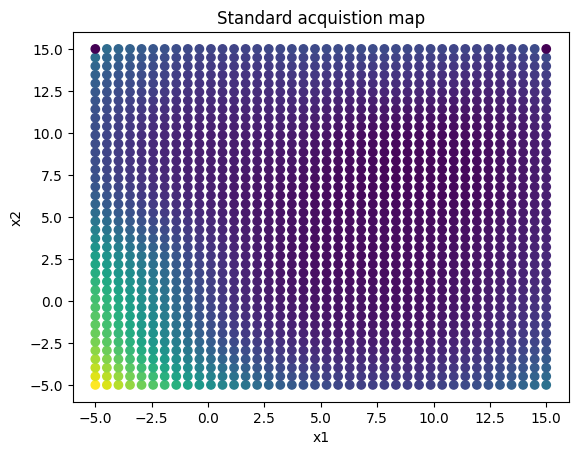

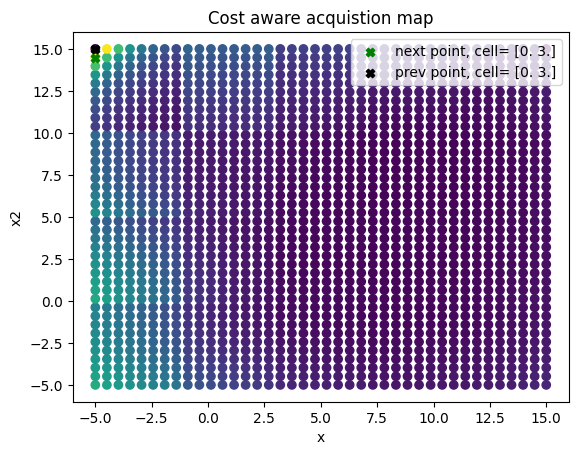

Measurement cost witin cell:1.5128205128205146
Measurement cost between cell:0.0
[1599   39   38]
Step:4


sample: 100%|██████████| 1000/1000 [00:04<00:00, 221.04it/s, 15 steps of size 2.16e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.49      0.33      0.43      0.00      0.95    384.31      1.00
          b      0.45      0.29      0.39      0.00      0.86    229.24      1.00
          c      0.58      0.38      0.53      0.00      1.10    140.98      1.00
k_length[0]      1.58      1.96      0.92      0.03      3.60    295.68      1.01
    k_scale      0.80      0.78      0.54      0.07      1.82    323.94      1.00
      noise      0.45      0.25      0.39      0.06      0.80    287.42      1.00



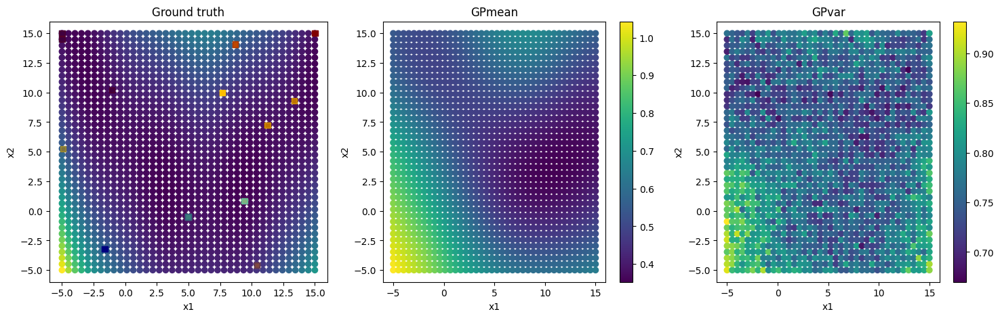

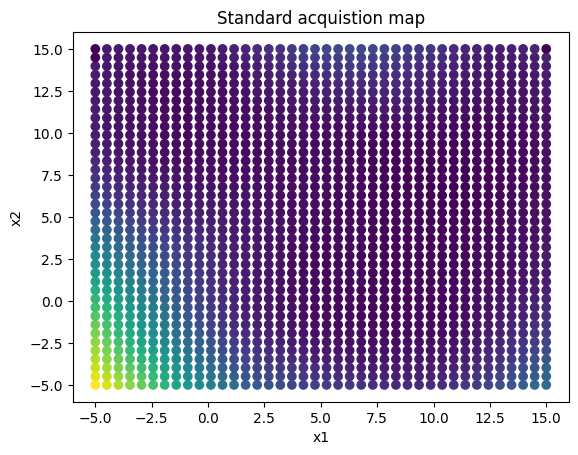

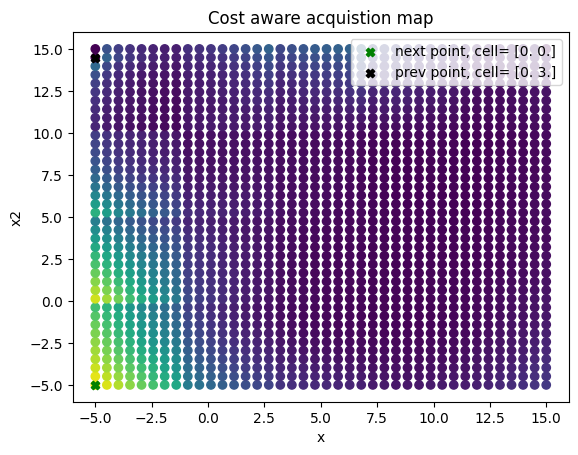

Measurement cost witin cell:0.0
Measurement cost between cell:7.0
[1599   39   38    0]
Step:5


sample: 100%|██████████| 1000/1000 [00:04<00:00, 226.39it/s, 15 steps of size 2.69e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.55      0.28      0.54      0.11      1.00    229.20      1.00
          b      0.61      0.31      0.62      0.13      1.13    230.27      1.00
          c      1.34      0.63      1.35      0.25      2.29    256.96      1.00
k_length[0]      0.99      1.41      0.51      0.09      2.20    176.34      1.00
    k_scale      1.60      1.53      1.20      0.12      3.15    186.28      1.00
      noise      1.02      0.61      0.90      0.08      1.80    261.44      1.00



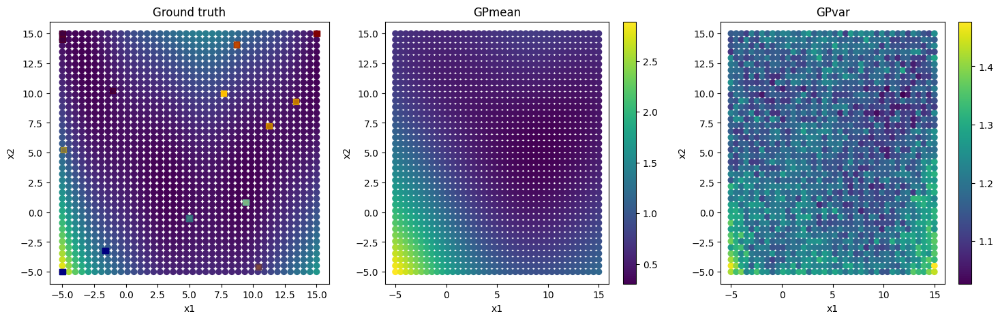

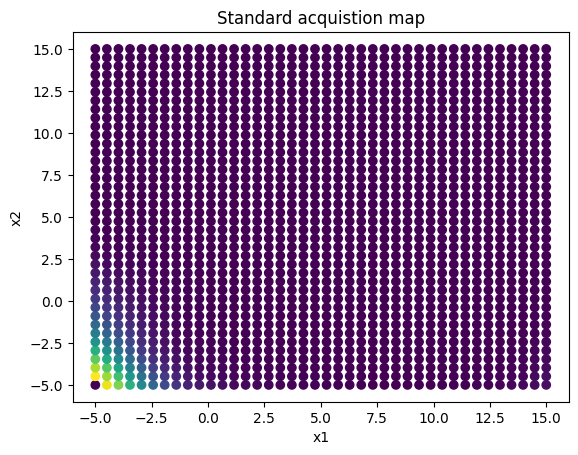

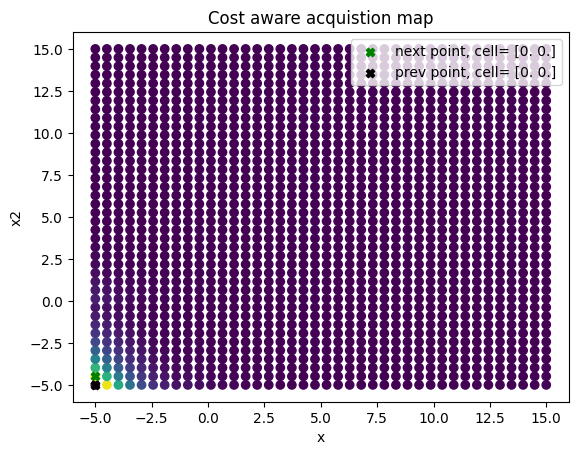

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1599   39   38    0    1]
Step:6


sample: 100%|██████████| 1000/1000 [00:04<00:00, 223.14it/s, 7 steps of size 2.86e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.29      0.54      0.04      0.96    209.95      1.00
          b      0.59      0.32      0.58      0.00      0.99    165.59      1.00
          c      1.47      0.70      1.50      0.37      2.65    138.37      1.00
k_length[0]      0.43      0.35      0.36      0.11      0.83    257.47      1.00
    k_scale      2.39      1.95      1.74      0.29      4.96    198.17      1.00
      noise      0.65      0.54      0.47      0.03      1.43    149.16      1.00



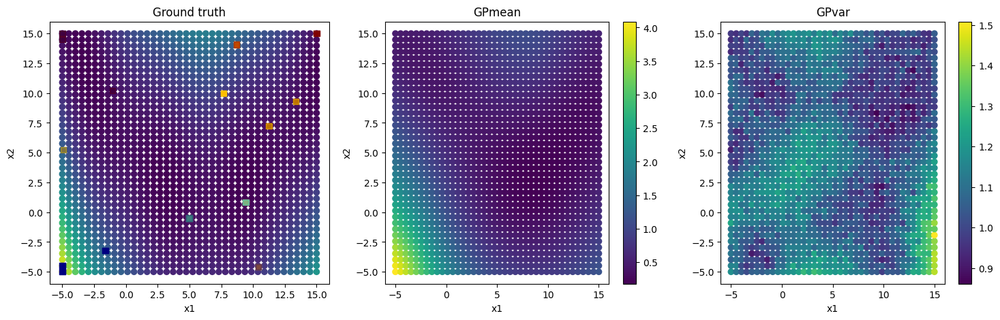

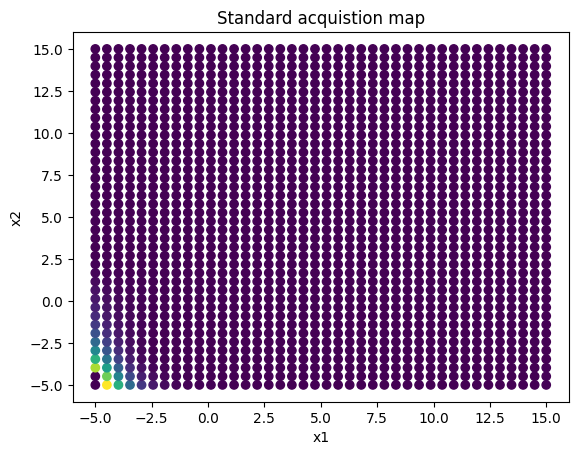

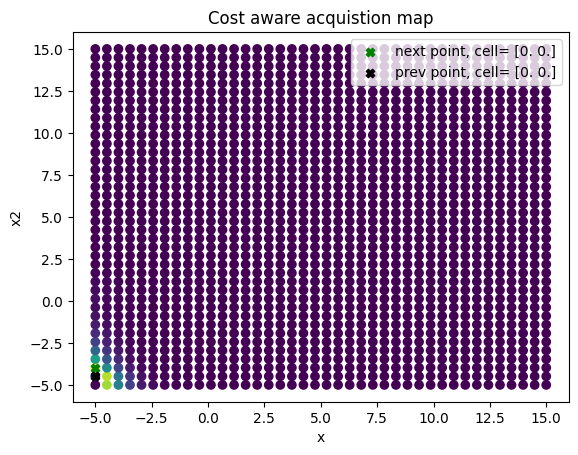

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1599   39   38    0    1    2]
Step:7


sample: 100%|██████████| 1000/1000 [00:04<00:00, 216.30it/s, 15 steps of size 2.13e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.56      0.31      0.53      0.10      1.02    178.14      1.00
          b      0.60      0.31      0.59      0.12      1.10    267.61      1.00
          c      1.52      0.70      1.47      0.48      2.76    255.92      1.01
k_length[0]      0.38      0.20      0.35      0.08      0.63    195.97      1.00
    k_scale      2.76      2.10      2.30      0.32      4.93    223.00      1.01
      noise      0.43      0.36      0.34      0.03      0.92    239.81      1.01



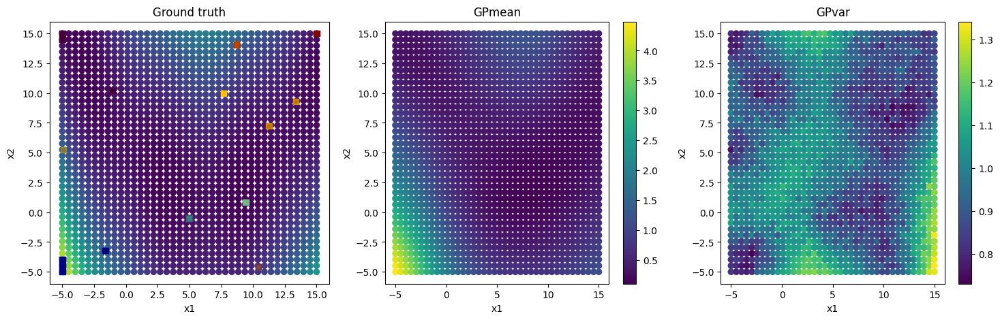

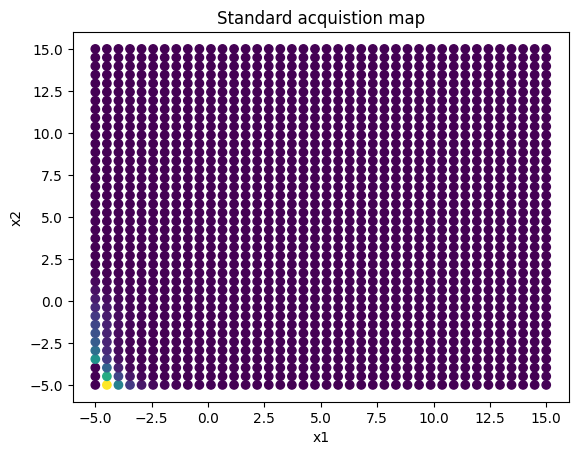

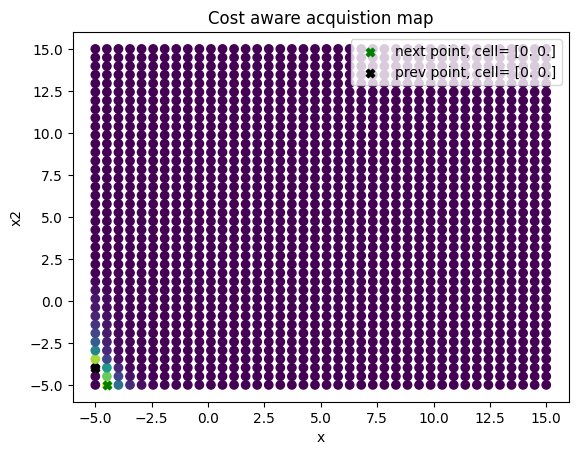

Measurement cost witin cell:2.5384615384615383
Measurement cost between cell:0.0
[1599   39   38    0    1    2   40]
Step:8


sample: 100%|██████████| 1000/1000 [00:04<00:00, 213.06it/s, 7 steps of size 2.42e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.57      0.31      0.56      0.12      1.02    297.90      1.01
          b      0.61      0.29      0.59      0.14      1.08    264.19      1.01
          c      1.59      0.67      1.58      0.64      2.81    163.30      1.00
k_length[0]      0.35      0.18      0.33      0.09      0.55    167.48      1.00
    k_scale      2.78      2.07      2.18      0.56      5.13    173.50      1.01
      noise      0.34      0.32      0.24      0.02      0.71    193.14      1.00



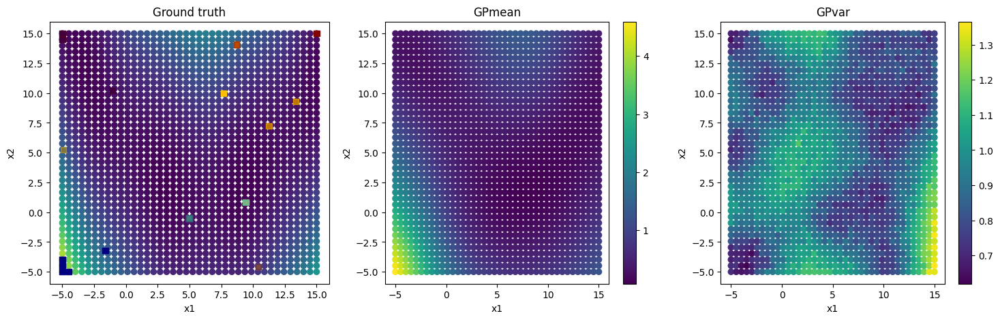

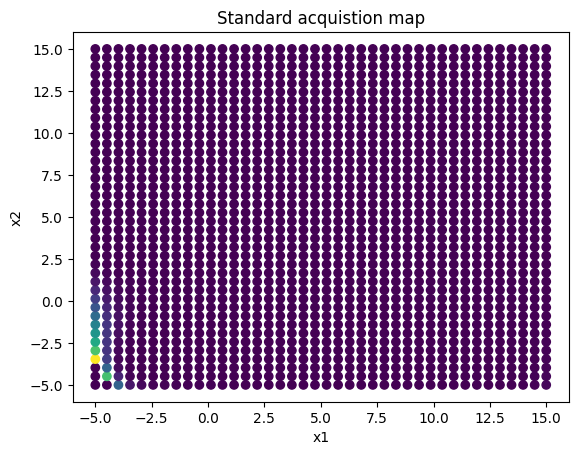

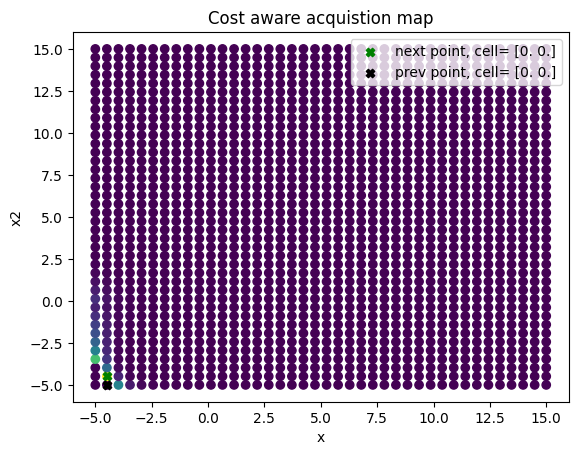

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1599   39   38    0    1    2   40   41]
Step:9


sample: 100%|██████████| 1000/1000 [00:04<00:00, 217.38it/s, 7 steps of size 3.50e-01. acc. prob=0.82]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.57      0.30      0.55      0.11      1.03    214.17      1.00
          b      0.58      0.30      0.57      0.12      1.05    122.61      1.04
          c      1.56      0.68      1.51      0.40      2.58    279.52      1.00
k_length[0]      0.33      0.16      0.31      0.10      0.55    236.24      1.00
    k_scale      2.99      2.54      2.24      0.48      5.82    217.76      1.01
      noise      0.25      0.22      0.17      0.02      0.57    328.75      1.00



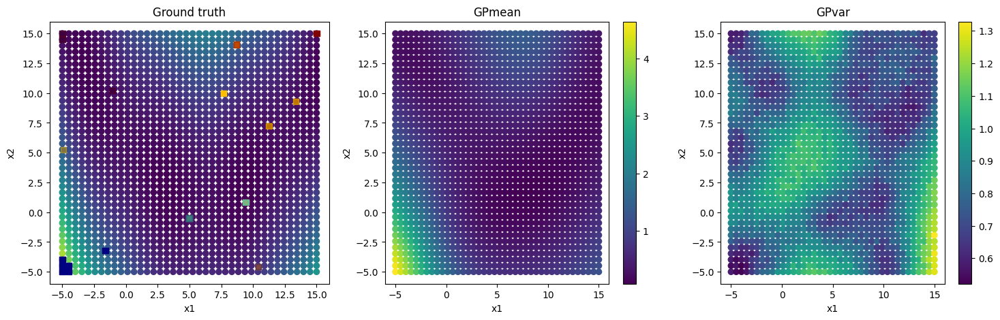

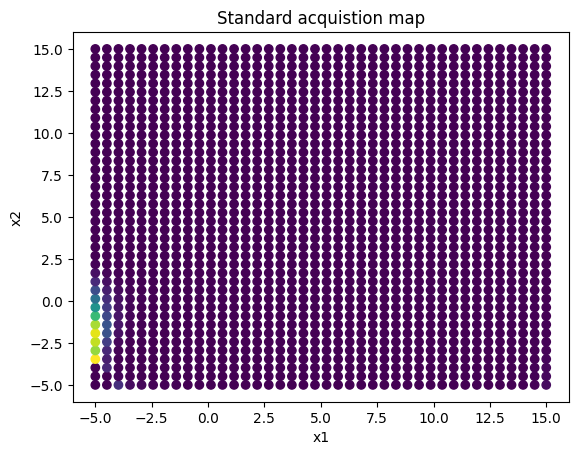

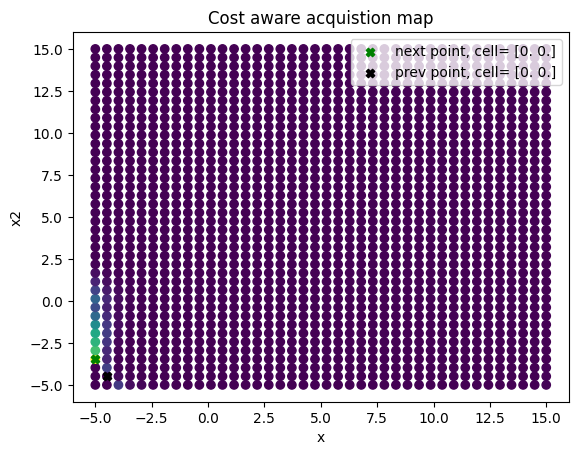

Measurement cost witin cell:2.5384615384615383
Measurement cost between cell:0.0
[1599   39   38    0    1    2   40   41    3]
Step:10


sample: 100%|██████████| 1000/1000 [00:04<00:00, 211.66it/s, 7 steps of size 2.30e-01. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.30      0.50      0.07      1.01    162.59      1.01
          b      0.61      0.30      0.61      0.12      1.11    168.04      1.00
          c      1.59      0.65      1.56      0.49      2.64    230.20      1.00
k_length[0]      0.32      0.15      0.30      0.09      0.51    273.88      1.00
    k_scale      2.84      2.35      2.14      0.50      5.17    201.11      1.00
      noise      0.19      0.17      0.13      0.02      0.40    245.09      1.00



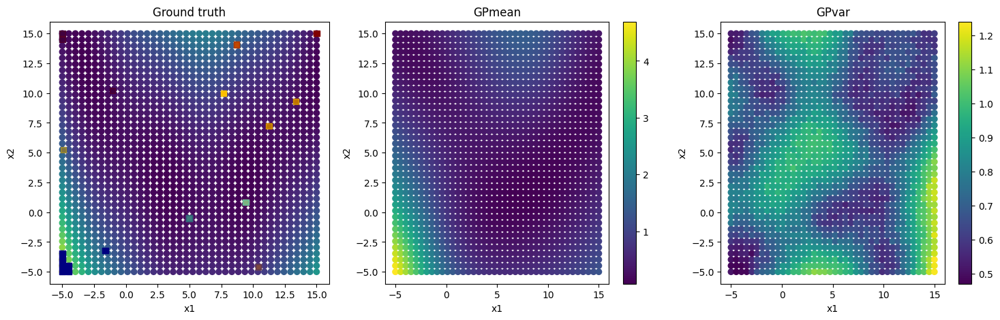

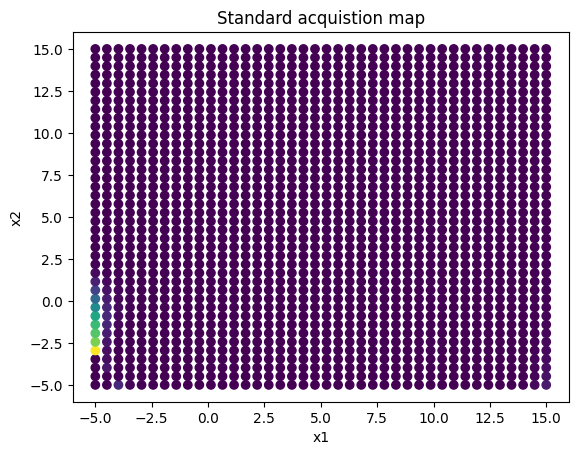

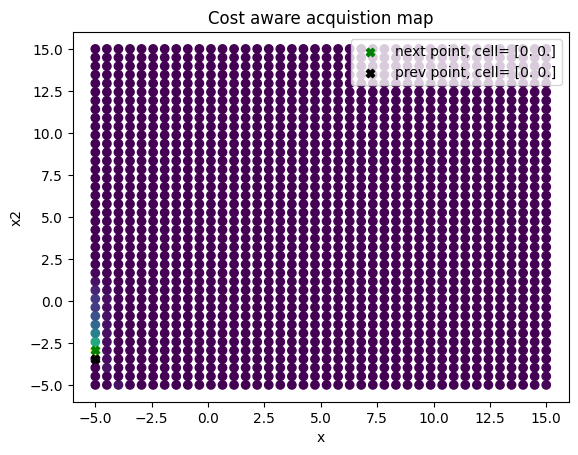

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1599   39   38    0    1    2   40   41    3    4]
Step:11


sample: 100%|██████████| 1000/1000 [00:04<00:00, 207.87it/s, 7 steps of size 1.99e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.56      0.33      0.51      0.09      1.05    189.35      1.01
          b      0.60      0.32      0.59      0.06      1.04    206.69      1.00
          c      1.47      0.76      1.46      0.15      2.58     82.78      1.00
k_length[0]      0.34      0.12      0.32      0.15      0.52    272.70      1.01
    k_scale      3.40      2.82      2.56      0.68      6.43    206.79      1.01
      noise      0.15      0.12      0.11      0.02      0.32    216.02      1.00



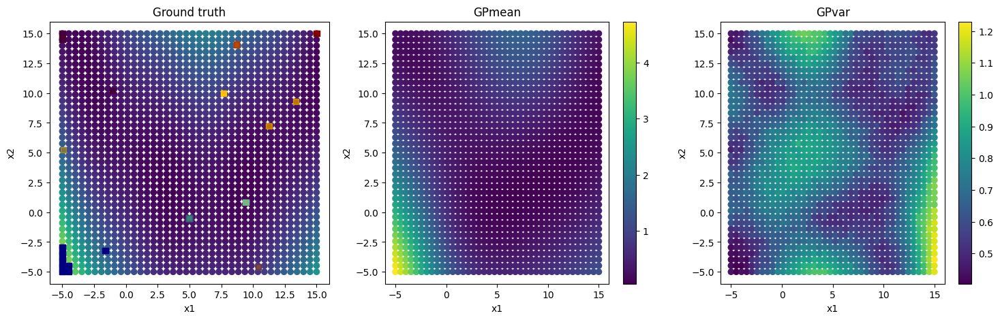

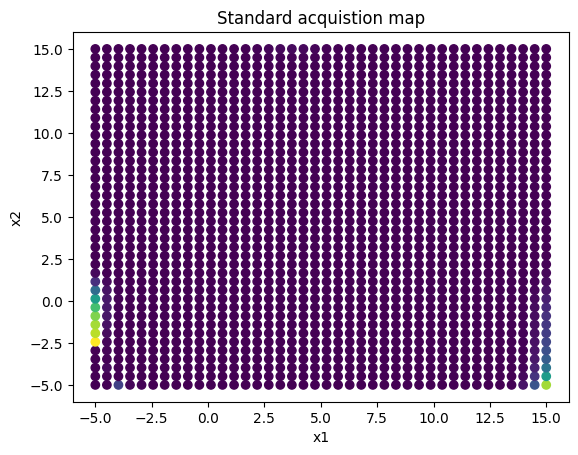

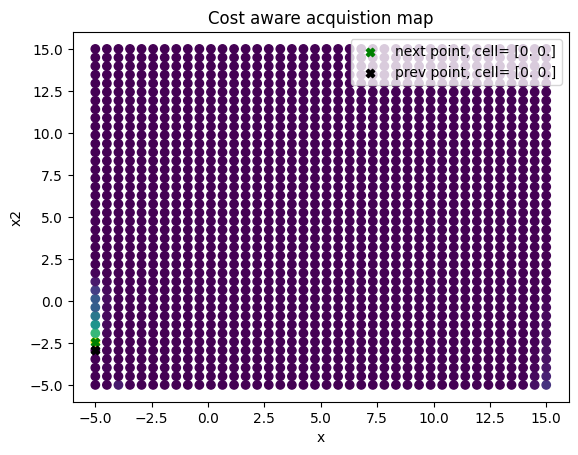

Measurement cost witin cell:1.5128205128205128
Measurement cost between cell:0.0
[1599   39   38    0    1    2   40   41    3    4    5]
Step:12


sample: 100%|██████████| 1000/1000 [00:04<00:00, 202.32it/s, 7 steps of size 2.79e-01. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.32      0.48      0.04      1.01    139.87      1.00
          b      0.60      0.31      0.60      0.01      1.01    196.07      1.00
          c      1.55      0.68      1.53      0.39      2.69    191.62      1.00
k_length[0]      0.32      0.12      0.30      0.15      0.51    119.78      1.00
    k_scale      3.28      2.87      2.39      0.83      6.40    120.94      1.00
      noise      0.11      0.11      0.08      0.01      0.24    207.47      1.00



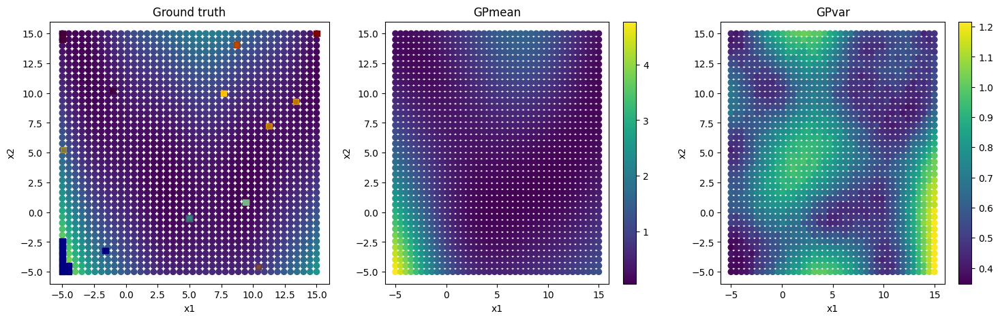

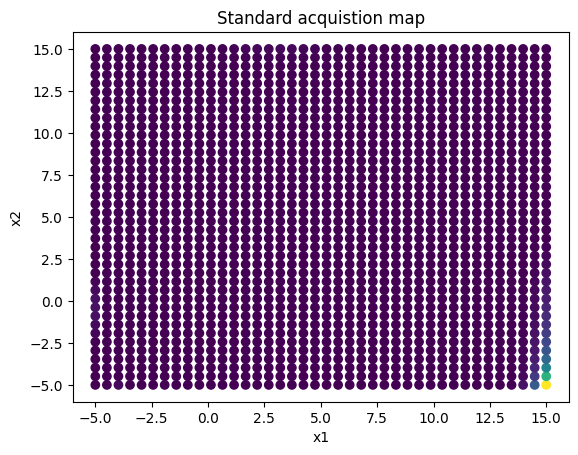

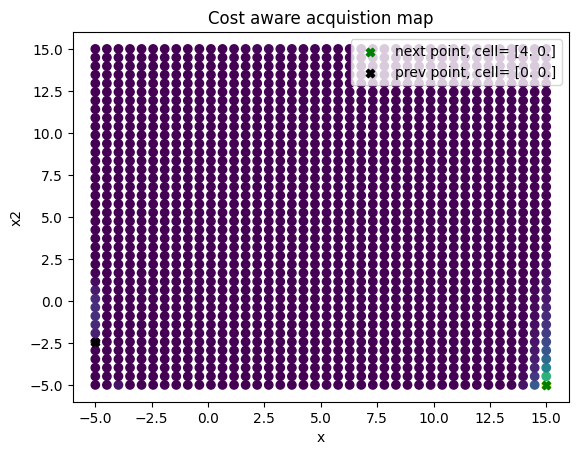

Measurement cost witin cell:0.0
Measurement cost between cell:9.0
[1599   39   38    0    1    2   40   41    3    4    5 1560]
Step:13


sample: 100%|██████████| 1000/1000 [00:04<00:00, 201.72it/s, 7 steps of size 1.78e-01. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.46      0.28      0.42      0.00      0.85    112.79      1.00
          b      0.66      0.29      0.67      0.10      1.07    186.48      1.00
          c      1.88      0.80      1.82      0.67      3.16    126.62      1.02
k_length[0]      0.33      0.12      0.32      0.15      0.54    163.10      1.00
    k_scale      3.52      2.86      2.58      0.58      7.07    165.21      1.01
      noise      0.11      0.11      0.08      0.01      0.24    150.16      1.01



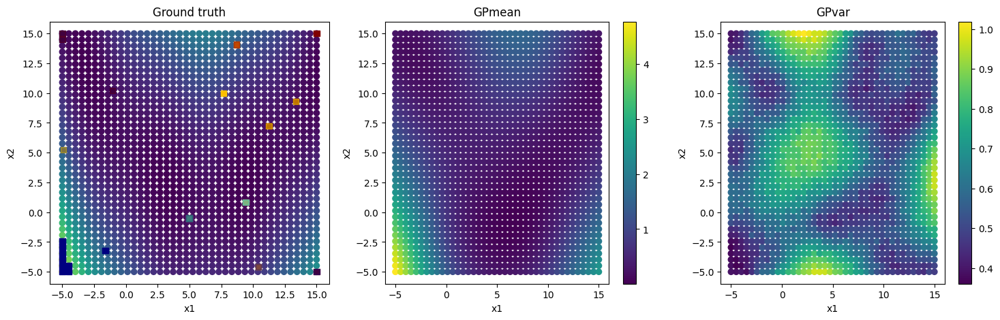

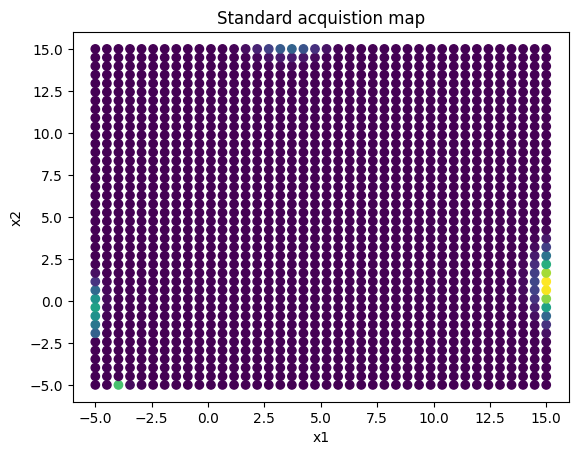

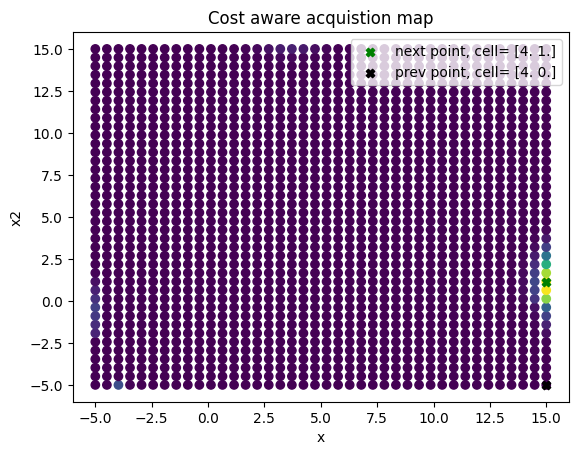

Measurement cost witin cell:0.0
Measurement cost between cell:3.0
[1599   39   38    0    1    2   40   41    3    4    5 1560 1572]
Step:14


sample: 100%|██████████| 1000/1000 [00:05<00:00, 171.81it/s, 15 steps of size 2.59e-01. acc. prob=0.79]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.43      0.29      0.34      0.01      0.82    128.45      1.01
          b      0.67      0.31      0.67      0.09      1.10    136.63      1.00
          c      1.91      0.78      1.85      0.74      3.17    155.69      1.00
k_length[0]      0.37      0.12      0.36      0.17      0.55    212.58      1.00
    k_scale      3.94      3.25      3.10      0.77      8.06    248.07      1.00
      noise      0.11      0.08      0.09      0.01      0.21    257.45      1.00



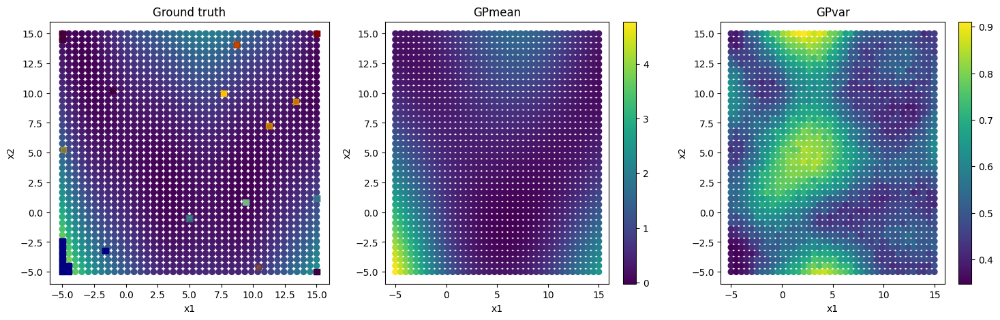

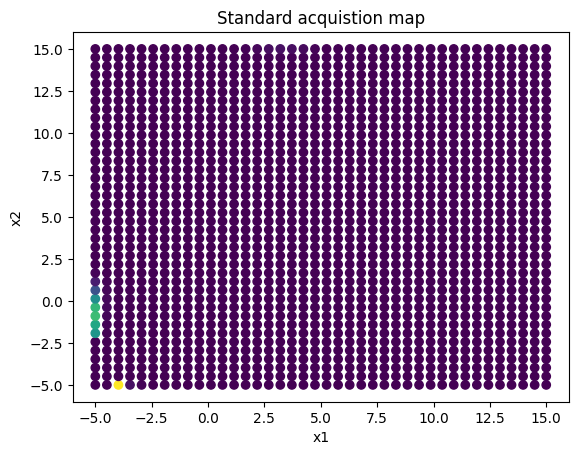

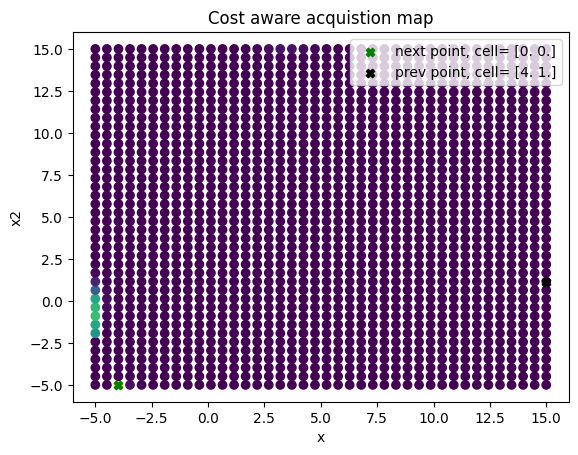

Measurement cost witin cell:0.0
Measurement cost between cell:11.0
[1599   39   38    0    1    2   40   41    3    4    5 1560 1572   80]
Step:15


sample: 100%|██████████| 1000/1000 [00:05<00:00, 197.11it/s, 7 steps of size 2.12e-01. acc. prob=0.81]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.43      0.29      0.34      0.08      0.86     89.65      1.00
          b      0.67      0.30      0.67      0.10      1.10    156.28      1.00
          c      2.04      0.81      1.99      0.86      3.34    133.78      1.02
k_length[0]      0.37      0.13      0.36      0.17      0.58    101.14      1.02
    k_scale      4.51      3.76      3.32      0.55      9.16    110.03      1.01
      noise      0.09      0.07      0.06      0.01      0.17    254.19      1.03



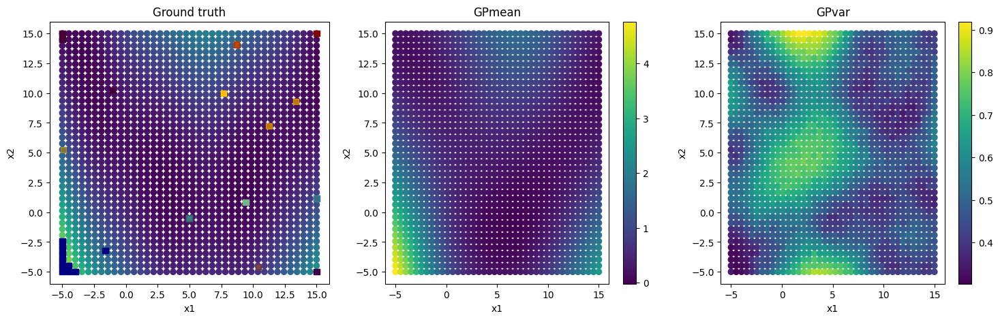

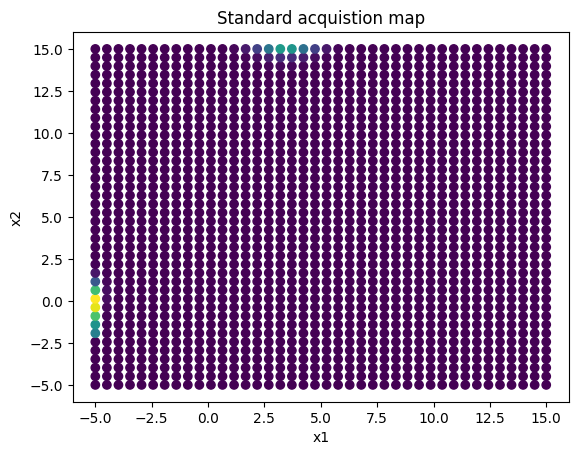

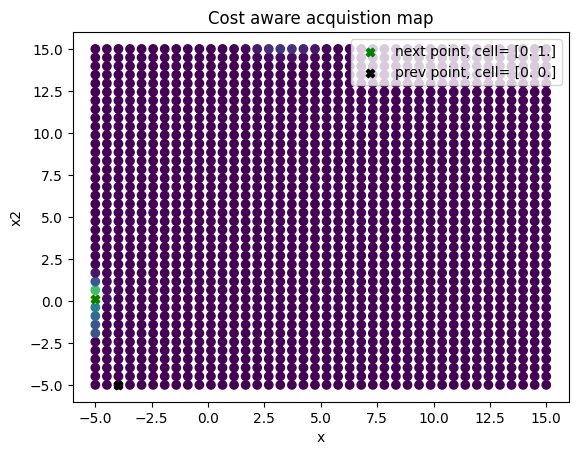

Measurement cost witin cell:0.0
Measurement cost between cell:3.0
[1599   39   38    0    1    2   40   41    3    4    5 1560 1572   80
   10]


In [19]:
N = 15
X_test =cxs
X_test_full = cxs
X_test_norm = np.zeros_like(X_test)
X_test_norm[:, 0:2] = (X_test[:, 0:2]-bounds[0])/(bounds[1]-bounds[0])
X_test_norm[:, -2:] = X_test[:, -2:]

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
cost = np.zeros((N, 2))
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel='RBF',mean_fn=mean_func, mean_fn_prior=mf_priors)
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_norm[:, 0:2], train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[:, 0:2])

        fig, ax = plt.subplots(ncols = 3, figsize=(18, 5))
        ax[0].scatter(X_test[:, 0], X_test[:, 1], c=ys/100, cmap="viridis")
        ax[0].scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -2], cmap="jet", alpha =1, marker="s")
        ax[0].scatter(train_x[:, 0], train_x[:, 1], c=train_x[:, -1], cmap="jet", alpha =0.5, marker="s")
        #plt.colorbar(b, orientation='vertical')
        ax[0].set_xlabel("x1")
        ax[0].set_ylabel("x2")
        ax[0].set_title("Ground truth")

        b= ax[1].scatter(X_test[:, 0], X_test[:, 1], c=y_pred, cmap="viridis")
        plt.colorbar(b, orientation='vertical')
        ax[1].set_xlabel("x1")
        ax[1].set_ylabel("x2")
        ax[1].set_title("GPmean")

        b= ax[2].scatter(X_test[:, 0], X_test[:, 1], c=y_sampled.std(axis=(0,1)), cmap="viridis")
        plt.colorbar(b, orientation='vertical')
        ax[2].set_xlabel("x1")
        ax[2].set_ylabel("x2")
        ax[2].set_title("GPvar")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    cost_params = [t_m, t_c, a, center]
    acq, next_point_idx, next_point_val,  cost[i-1, :] = cost_acqfun(gp_model, train_x, test_data, cost_params, rng_key_predict, idx, isnorm=True)
    print("Measurement cost witin cell:"+str(cost[i-1, 0]))
    print("Measurement cost between cell:"+str(cost[i-1, 1]))

    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        train_x = np.vstack((train_x, next_point))
        next_point_norm = X_test_norm[next_point_idx]
        train_x_norm = np.vstack((train_x_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)
        train_y = objective(train_x[:, 0:2])
        train_y=train_y/100



31.641025641025642


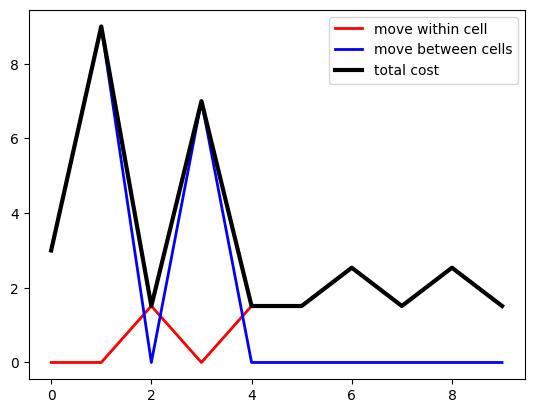

In [20]:
total_cost= np.sum(cost[:10,:])
print(total_cost)
plt.plot(cost[:10, 0], c="r", linewidth=2, label="move within cell")
plt.plot(cost[:10, 1], c="b", linewidth=2, label="move between cells")
plt.plot(np.sum(cost[:10, :],axis=1), c="k", linewidth=3, label="total cost")
plt.legend(loc="best")

We can see sGP accelerates toward the optimal solution just in 5 iterations

However, the cost based acqusition function still follows the rule of exploring locally (lost cost) with closer corners and then move to farther corners (high cost) for potention discovery of region of interest